In [1]:
# !/usr/bin/env python3
# -*- coding: utf-8 -*-
"""
Created on 20191125

@author: zhangji

test the linear relationship
U_t =?= U_sh + U_wm
U_t is the total velocity
U_sh is the velocity induced by shear flow
U_wm is the active velocity. 
"""

# %pylab inline
# pylab.rcParams['figure.figsize'] = (25, 11)
# fontsize = 40

# import numpy as np
# import scipy as sp
# from scipy.optimize import leastsq, curve_fit
# from scipy import interpolate
# from scipy.interpolate import interp1d
# from scipy.io import loadmat, savemat
# # import scipy.misc

# import matplotlib
# from matplotlib import pyplot as plt
# from matplotlib import animation, rc
# import matplotlib.ticker as mtick
# from mpl_toolkits.axes_grid1.inset_locator import inset_axes, zoomed_inset_axes
# from mpl_toolkits.mplot3d import Axes3D, axes3d

# from sympy import symbols, simplify, series, exp
# from sympy.matrices import Matrix
# from sympy.solvers import solve

# from IPython.display import display, HTML
# from tqdm import tqdm_notebook as tqdm
# import pandas as pd
# import re
# from scanf import scanf
# import os
# import glob

# from codeStore import support_fun as spf
# from src.support_class import *
# from src import stokes_flow as sf

# rc('animation', html='html5')
# PWD = os.getcwd()
# font = {'size': 20}
# matplotlib.rc('font', **font)
# np.set_printoptions(linewidth=90, precision=5)

%load_ext autoreload
%autoreload 2

import os
import glob
import re
import pandas as pd
from scanf import scanf
import natsort 
import numpy as np
import scipy as sp
from scipy.optimize import leastsq, curve_fit
from scipy import interpolate, spatial, sparse
# from scipy.interpolate import interp1d
from scipy.io import loadmat, savemat
# import scipy.misc
import importlib
from IPython.display import display, HTML
import pickle

import matplotlib
from matplotlib import pyplot as plt
from matplotlib import colors as mcolors
from matplotlib import animation, rc
import matplotlib.ticker as mtick
from mpl_toolkits.axes_grid1.inset_locator import inset_axes, zoomed_inset_axes
from mpl_toolkits.mplot3d import Axes3D, axes3d
from matplotlib import ticker, cm
from mpl_toolkits.axes_grid1 import make_axes_locatable

from time import time
from src import support_class as spc
from src import jeffery_model as jm
from codeStore import support_fun as spf
from codeStore import support_fun_table as spf_tb

# %matplotlib notebook

%matplotlib inline
rc('animation', html='html5')
rc('text', usetex=True)
params = {'text.latex.preamble': [r'\usepackage{bm}', r'\usepackage{amsmath}']}
plt.rcParams.update(params)
fontsize = 40
figsize = (30, 16)
PWD = os.getcwd()

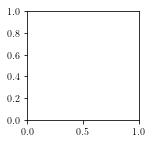

In [2]:
fig = plt.figure(figsize=(2, 2))
fig.patch.set_facecolor('white')
ax0 = fig.add_subplot(1, 1, 1)

In [3]:
fft_pickle = 'ecoC01B05_tao1_wm0'

In [4]:
# do 2D IFFT myself and compare with numpy version
use_idx_max = 6

# ((psi, ((theta, phi, ui))))
with open('%s.pickle' % fft_pickle, 'rb') as handle:
    pickle_data = pickle.load(handle)
ttheta, tphi = pickle_data[0][1][0][:2]
tpsi = np.array([ti[0] for ti in pickle_data])
tw = pickle_data[0][1][3][2].values

tw_fft = np.fft.fft2(tw)
th_freq = np.fft.fftfreq(ttheta.size, 1 / ttheta.size)
ph_freq = np.fft.fftshift(np.fft.fftfreq(tphi.size, 1 / tphi.size))
idx_max = np.dstack(np.unravel_index(np.argsort(np.abs(tw_fft).ravel()), tw_fft.shape))[0][::-1]
    
# numpy version IFFT
idx = np.zeros_like(tw_fft, dtype=bool)
for ti in idx_max[:use_idx_max]:
    idx[ti[0], ti[1]] = 1
tw_fft2 = tw_fft * idx
tw2 = np.fft.ifft2(tw_fft2)

# do IFFT myself
tw3 = np.zeros_like(tw2)
tM, tN = tw_fft.shape
tm, tn = np.meshgrid(np.arange(tM), np.arange(tN), indexing='ij')
for tk, tl in idx_max[:use_idx_max]:
    tAkl = tw_fft[tk, tl]
    tw3 = tw3 + tAkl * np.exp(2 * np.pi * 1j * (tm * tk / tM + tn * tl / tN)) / (tM * tN)
    print(tk, tl, tAkl)
    print((np.abs(tw3.imag) / np.abs(tw3)).max())
print((tw3 - tw).max(), (tw3 - tw2).max())

0 62 (12.322282060499273+186.54993062316677j)
0.9978255781505948
0 2 (12.32228206049927-186.54993062316677j)
1.949417348305176e-14
1 62 (-1.66261112101838-118.55247821283966j)
0.9999995120750792
31 2 (-1.662611121018379+118.55247821283966j)
5.84958253626296e-12
31 62 (-6.763320599799224-65.04220447451377j)
0.999977771663306
1 2 (-6.763320599799222+65.04220447451377j)
1.7102907182389048e-12
(0.09389979205627075+9.71445146547012e-17j) (4.191091917959966e-15+4.371503159461554e-15j)


In [5]:
# print values of primary frequence
print_idx_max = 20

# ((psi, ((theta, phi, ui))))
with open('%s.pickle' % fft_pickle, 'rb') as handle:
    pickle_data = pickle.load(handle)
ttheta, tphi = pickle_data[0][1][0][:2]
tpsi = np.array([ti[0] for ti in pickle_data])
tw = pickle_data[0][1][3][2].values

tw_fft = np.fft.fft2(tw)
th_freq = np.fft.fftfreq(ttheta.size, 1 / ttheta.size)
ph_freq = np.fft.fftshift(np.fft.fftfreq(tphi.size, 1 / tphi.size))
idx_max = np.dstack(np.unravel_index(np.argsort(np.abs(tw_fft).ravel()), tw_fft.shape))[0][::-1]
for i0, (tk, tl) in enumerate(idx_max[:print_idx_max]):
    if not np.mod(i0, 2):
        print('*', tk, tl, tw_fft[tk, tl])
    else:
        print(' ', tk, tl, tw_fft[tk, tl])

* 0 62 (12.322282060499273+186.54993062316677j)
  0 2 (12.32228206049927-186.54993062316677j)
* 1 62 (-1.66261112101838-118.55247821283966j)
  31 2 (-1.662611121018379+118.55247821283966j)
* 31 62 (-6.763320599799224-65.04220447451377j)
  1 2 (-6.763320599799222+65.04220447451377j)
* 1 0 (5.840870488550582-43.57639647516834j)
  31 0 (5.840870488550581+43.57639647516834j)
* 2 0 (-3.3748645574344365+18.366389851436942j)
  30 0 (-3.3748645574344365-18.366389851436942j)
* 2 62 (-0.3276035898825703+9.399733729705302j)
  30 2 (-0.3276035898825703-9.3997337297053j)
* 0 61 (-0.9266704645376043-7.324557978806616j)
  0 3 (-0.9266704645376043+7.324557978806615j)
* 30 62 (-1.2815269973502885-5.050734661111762j)
  2 2 (-1.281526997350288+5.050734661111759j)
* 31 3 (0.3067896714543265-4.318452578625892j)
  1 61 (0.30678967145432673+4.318452578625891j)
* 0 0 (-4.167786366297719+0j)
  0 60 (-0.7339741398981741-4.03885578867248j)


use frequence pairs 12.322282+186.549931i and 12.322282-186.549931i at (0, 62) and (0, 2)
absolute abs of imag part is 8.673617379884035e-19
use frequence pairs -1.662611-118.552478i and -1.662611+118.552478i at (1, 62) and (31, 2)
absolute abs of imag part is 6.938893903907228e-18
use frequence pairs -6.763321-65.042204i and -6.763321+65.042204i at (31, 62) and (1, 2)
absolute abs of imag part is 8.673617379884035e-19
use frequence pairs 5.840870-43.576396i and 5.840870+43.576396i at (1, 0) and (31, 0)
absolute abs of imag part is 3.469446951953614e-18


/anaconda3/envs/py35/lib/python3.5/site-packages/scipy/optimize/minpack.py:808: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


use frequence pairs 12.322282+186.549931i and 12.322282-186.549931i at (0, 62) and (0, 2)
use frequence pairs -1.662611-118.552478i and -1.662611+118.552478i at (1, 62) and (31, 2)
use frequence pairs -6.763321-65.042204i and -6.763321+65.042204i at (31, 62) and (1, 2)
use frequence pairs 5.840870-43.576396i and 5.840870+43.576396i at (1, 0) and (31, 0)
absolute abs of imag part is 6.938893903907228e-18


True

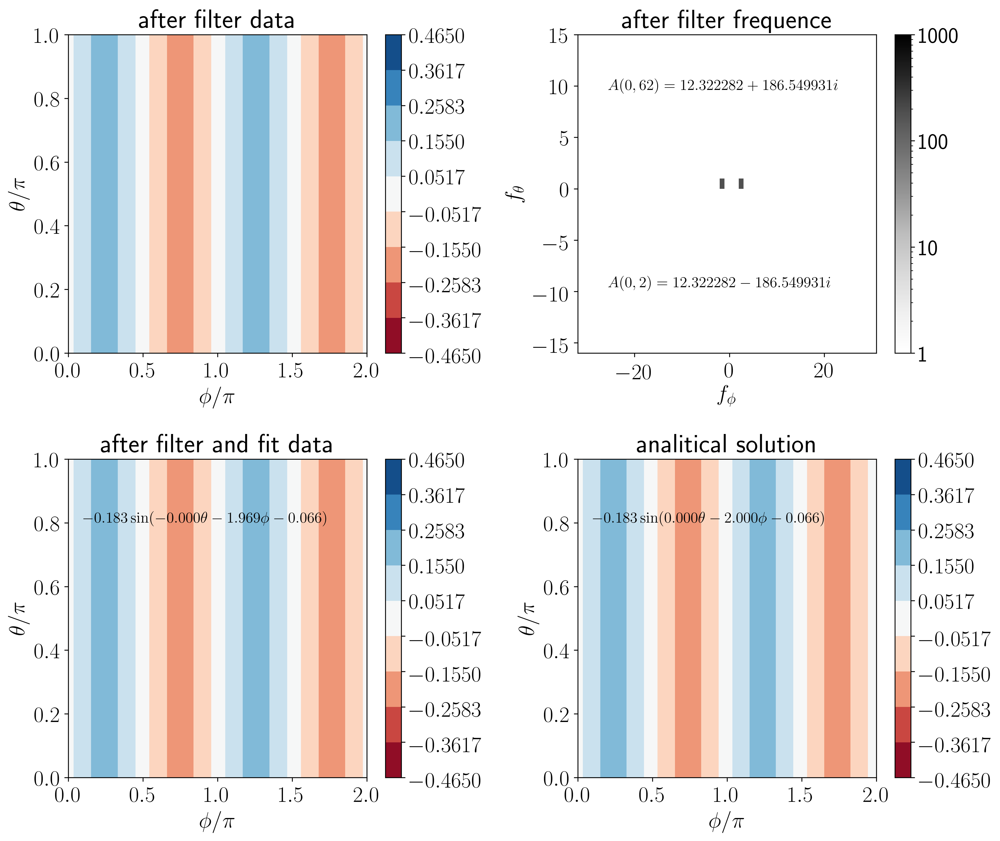

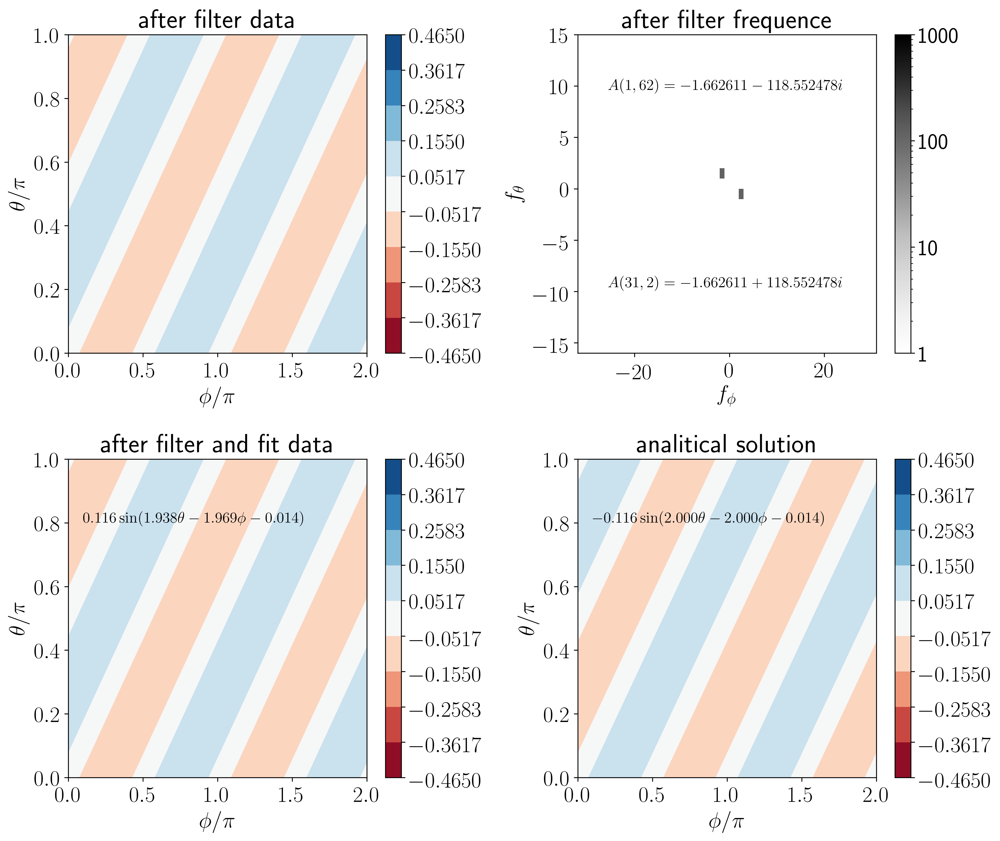

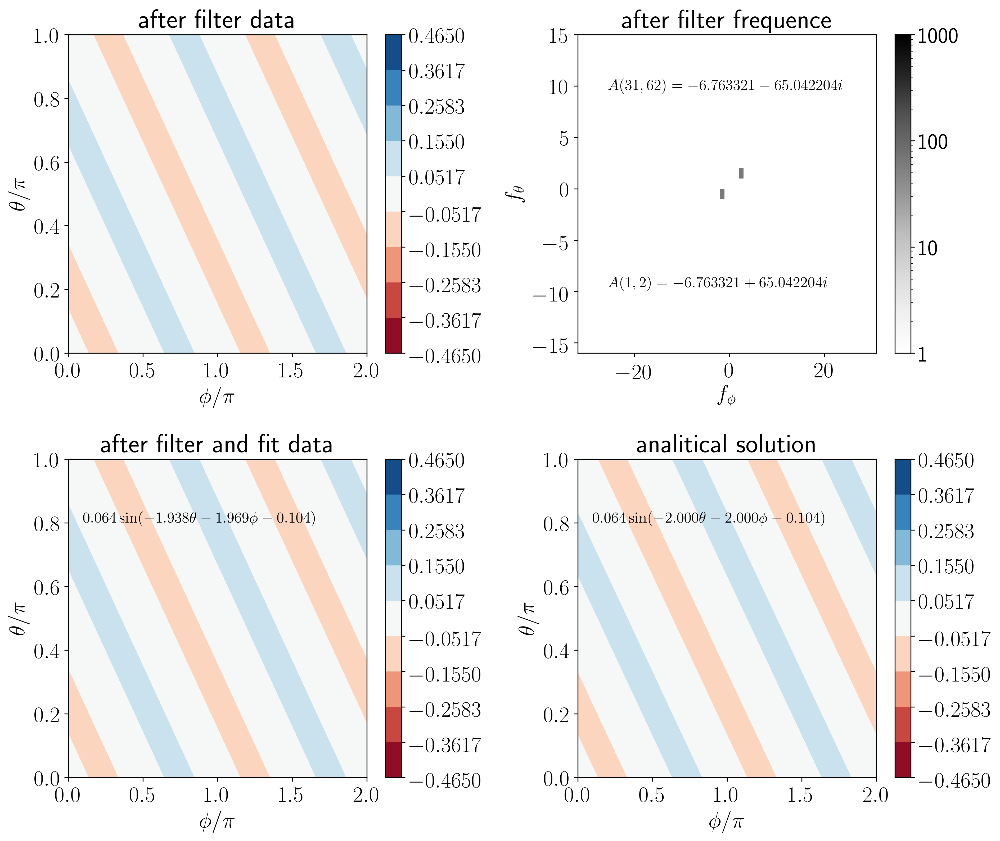

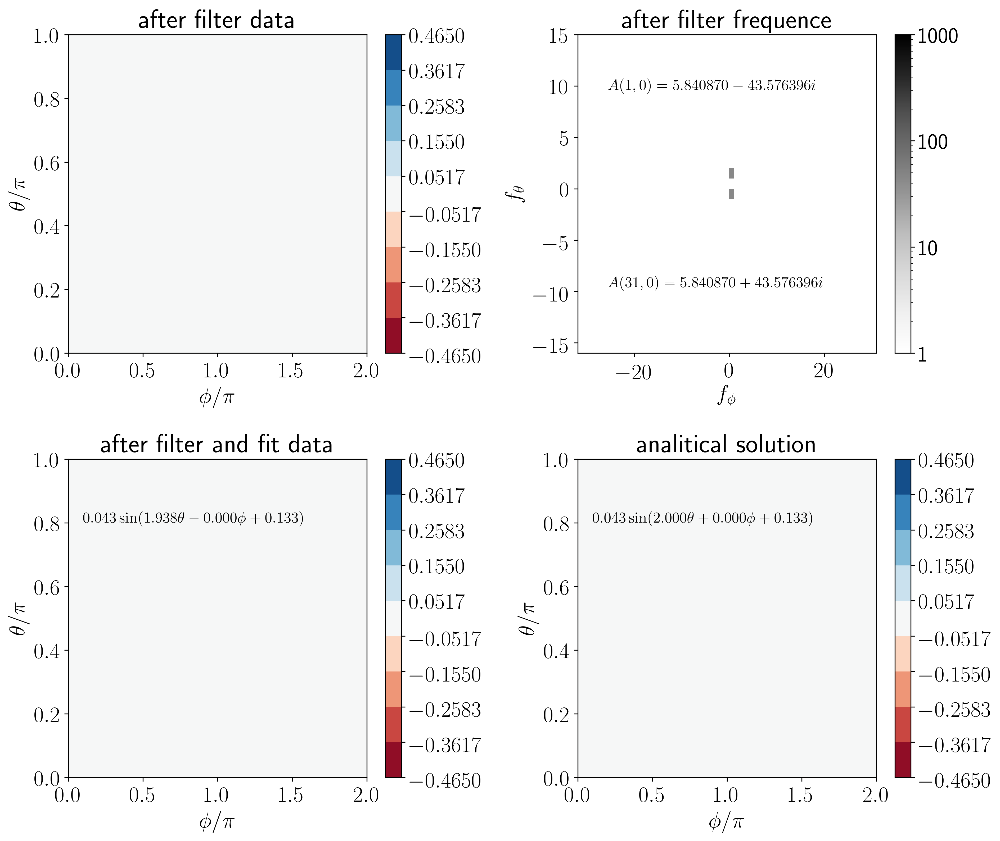

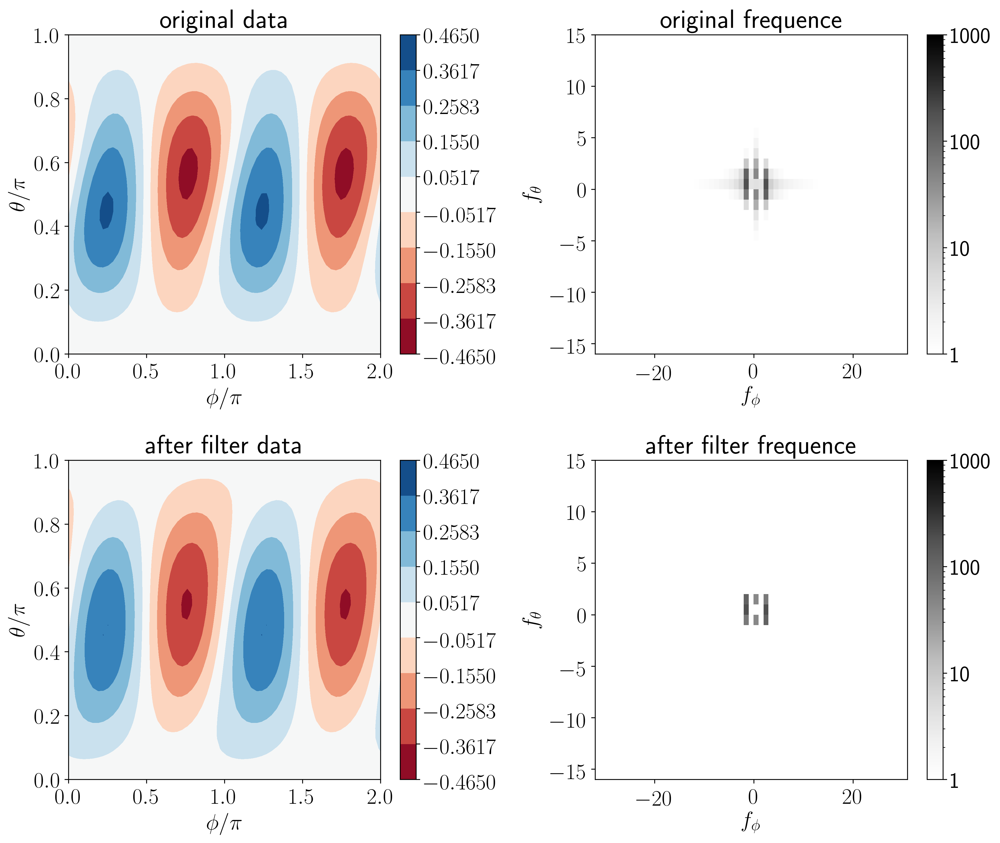

In [6]:
# 2D fft of Wx, Wy, Wz
importlib.reload(spf_tb)
use_uidx = 3 # 3: wx, 4: wy, 5: wz
tktl_list = [[0, 62], [1, 62], [31, 62], [1, 0]]
# use_idx_list = [[0], [1, 2], [3, 4], [5, 6]]

# ((psi, ((theta, phi, ui))))
with open('%s.pickle' % fft_pickle, 'rb') as handle:
    pickle_data = pickle.load(handle)
ttheta, tphi = pickle_data[0][1][0][:2]
tpsi = np.array([ti[0] for ti in pickle_data])
tw = pickle_data[0][1][use_uidx][2].values

for tktl in tktl_list:
    if np.sum(tktl) < 1:
        spf_tb.show_fft_major(tw, (tktl, ), ttheta, tphi)
    else:
        spf_tb.show_fft_fit(tw, tktl, ttheta, tphi)

spf_tb.show_fft_major(tw, tktl_list, ttheta, tphi)

use frequence pairs 12.322282+186.549931i and 12.322282-186.549931i at (0, 62) and (0, 2)
absolute abs of imag part is 8.673617379884035e-19
use frequence pairs 7.224083+139.006877i and 7.224083-139.006877i at (0, 62) and (0, 2)
absolute abs of imag part is 3.469446951953614e-18


/anaconda3/envs/py35/lib/python3.5/site-packages/scipy/optimize/minpack.py:808: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


use frequence pairs 2.211306+77.184098i and 2.211306-77.184098i at (0, 62) and (0, 2)
absolute abs of imag part is 3.469446951953614e-18
use frequence pairs 0.168046+42.034554i and 0.168046-42.034554i at (0, 62) and (0, 2)
absolute abs of imag part is 8.673617379884035e-19
use frequence pairs 2.986588+56.769275i and 2.986588-56.769275i at (0, 62) and (0, 2)
absolute abs of imag part is 2.0687198856113594e-47
use frequence pairs 10.327617+111.494368i and 10.327617-111.494368i at (0, 62) and (0, 2)
absolute abs of imag part is 5.735151695798081e-47
use frequence pairs 18.957933+169.825834i and 18.957933-169.825834i at (0, 62) and (0, 2)
absolute abs of imag part is 6.938893903907228e-18


/anaconda3/envs/py35/lib/python3.5/site-packages/scipy/optimize/minpack.py:808: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


use frequence pairs 24.119143+193.063890i and 24.119143-193.063890i at (0, 62) and (0, 2)
absolute abs of imag part is 1.3877787807814457e-17
use frequence pairs 22.834926+165.805799i and 22.834926-165.805799i at (0, 62) and (0, 2)
absolute abs of imag part is 8.042749927373931e-47


/anaconda3/envs/py35/lib/python3.5/site-packages/scipy/optimize/minpack.py:808: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


use frequence pairs 16.485048+106.028963i and 16.485048-106.028963i at (0, 62) and (0, 2)
absolute abs of imag part is 6.938893903907228e-18
use frequence pairs 9.910474+53.221031i and 9.910474-53.221031i at (0, 62) and (0, 2)
absolute abs of imag part is 3.469446951953614e-18
use frequence pairs 7.477225+42.328066i and 7.477225-42.328066i at (0, 62) and (0, 2)
absolute abs of imag part is 1.7470526527517637e-47
use frequence pairs 9.695670+80.673651i and 9.695670-80.673651i at (0, 62) and (0, 2)
absolute abs of imag part is 6.938893903907228e-18
use frequence pairs 13.388211+143.051313i and 13.388211-143.051313i at (0, 62) and (0, 2)
absolute abs of imag part is 5.428919679139268e-47
use frequence pairs 14.777249+188.300775i and 14.777249-188.300775i at (0, 62) and (0, 2)
absolute abs of imag part is 8.212796229663827e-47


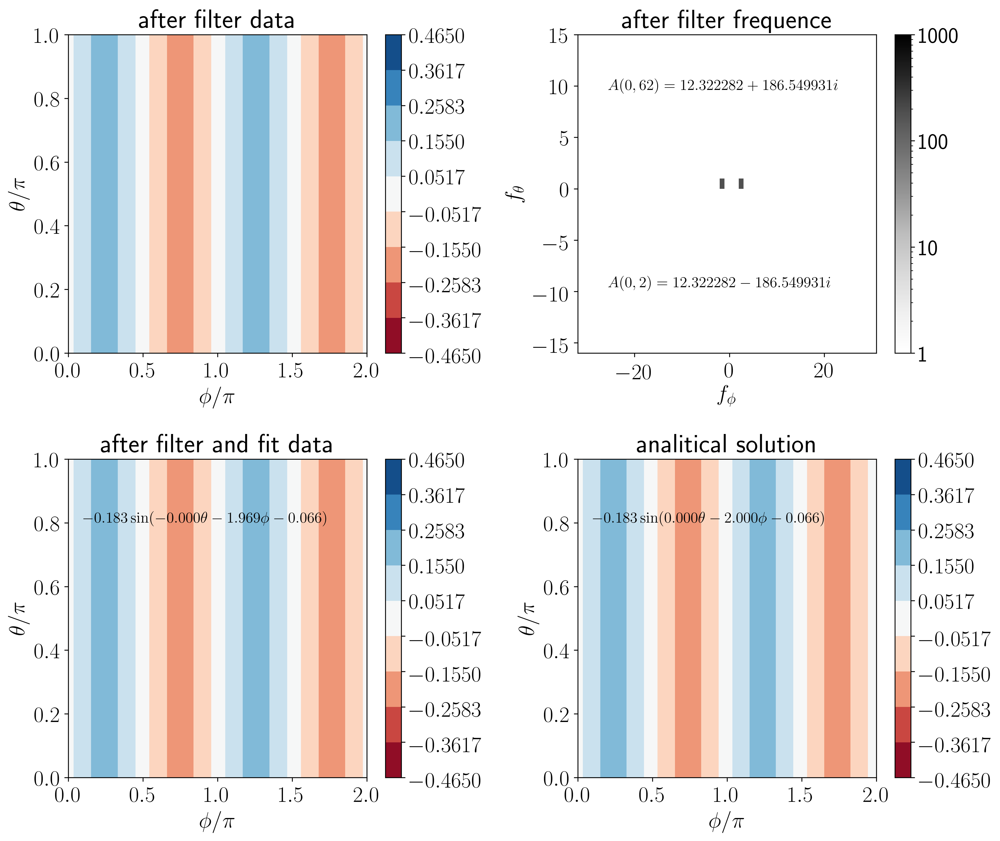

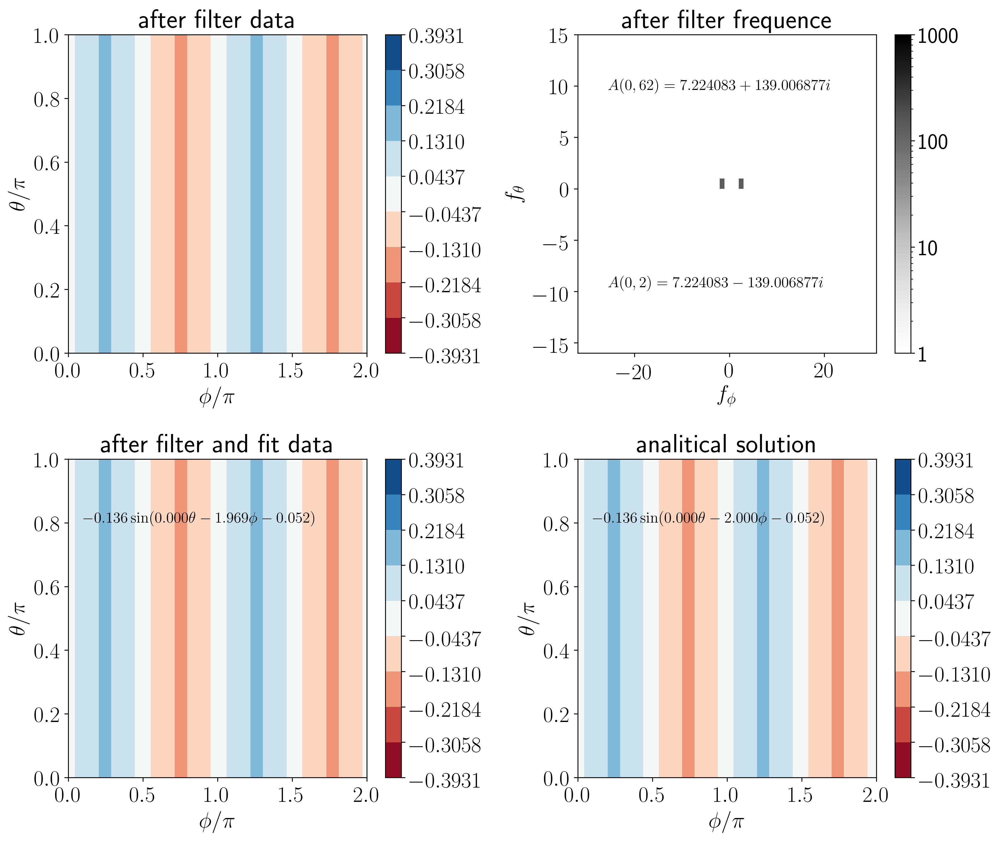

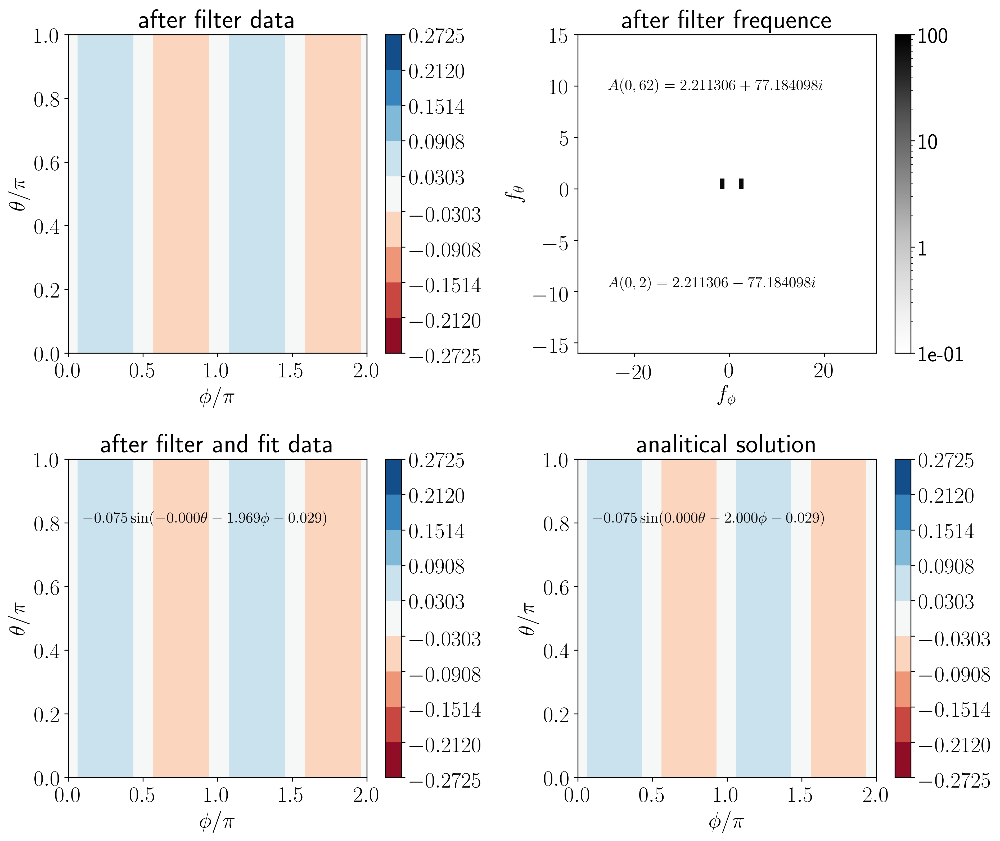

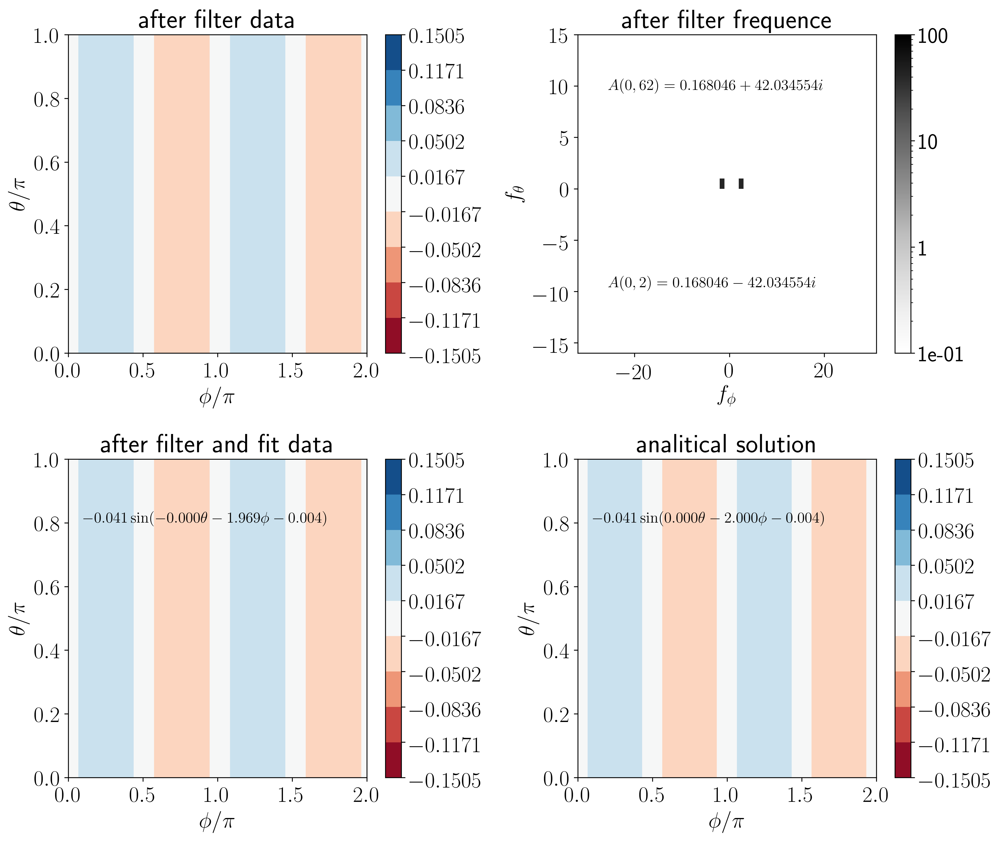

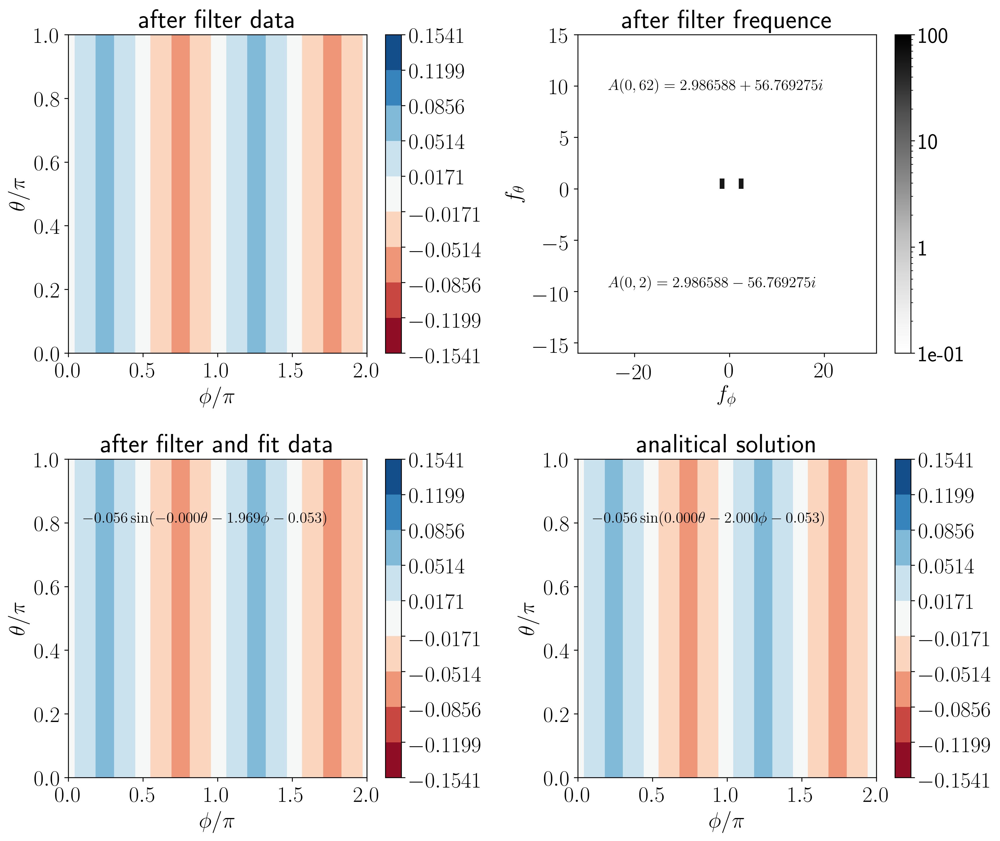

...

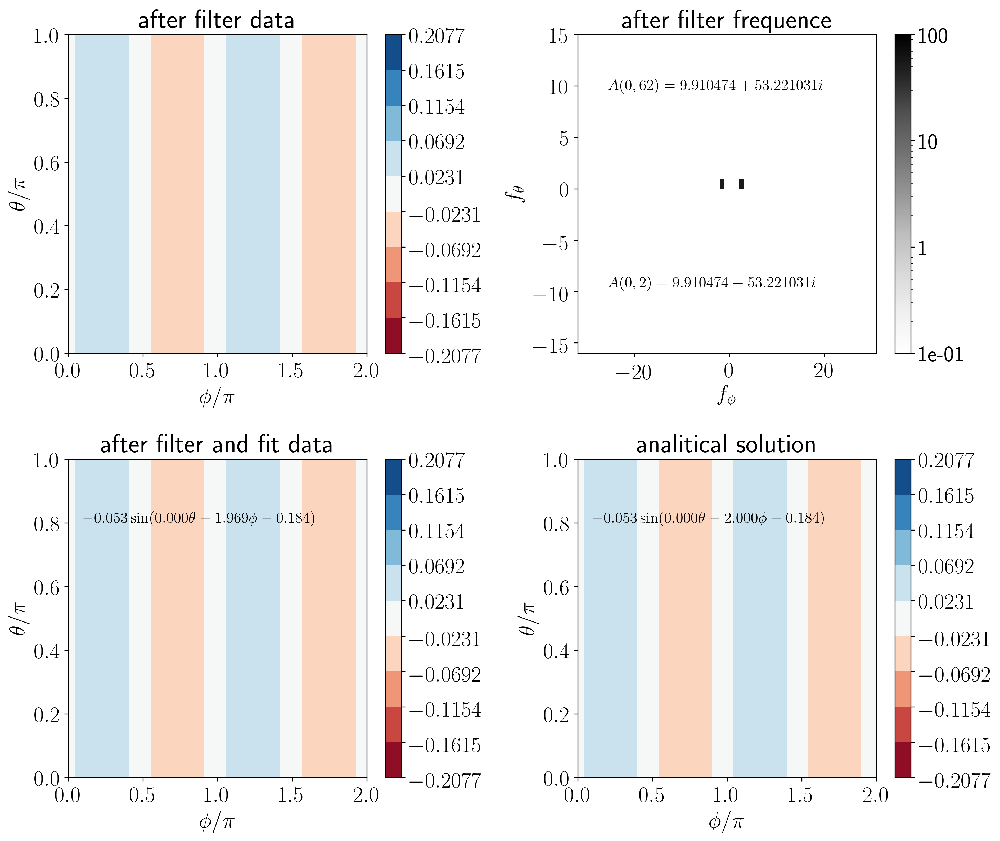

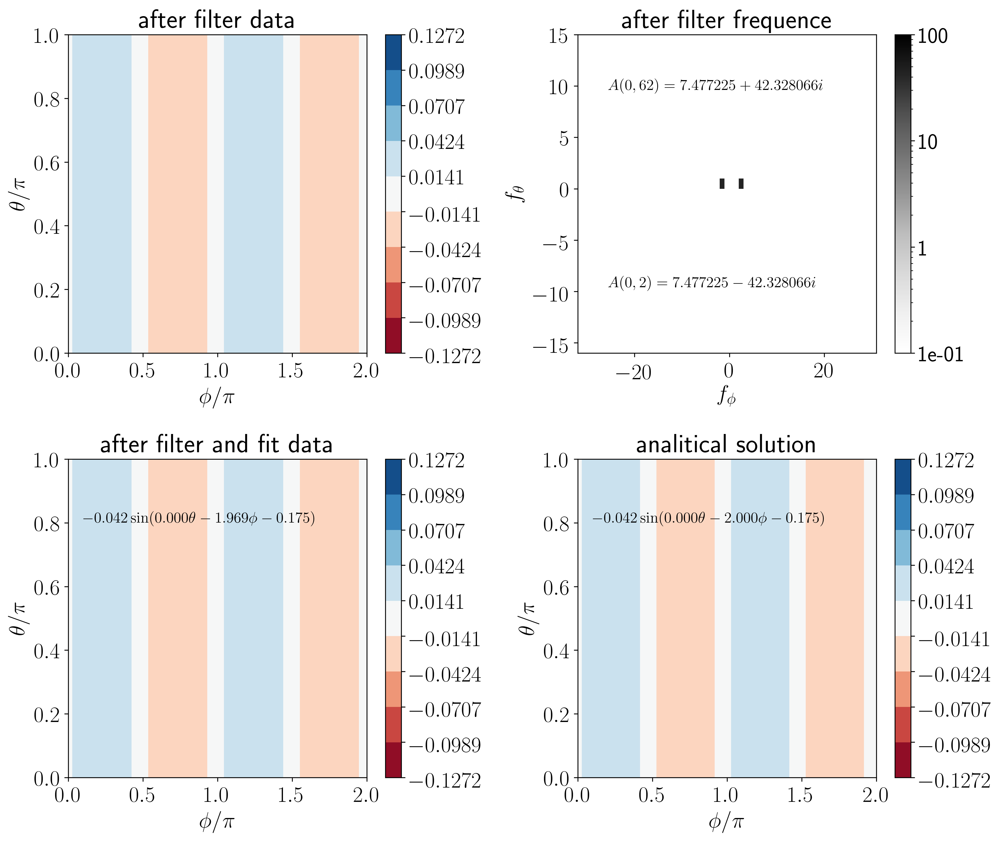

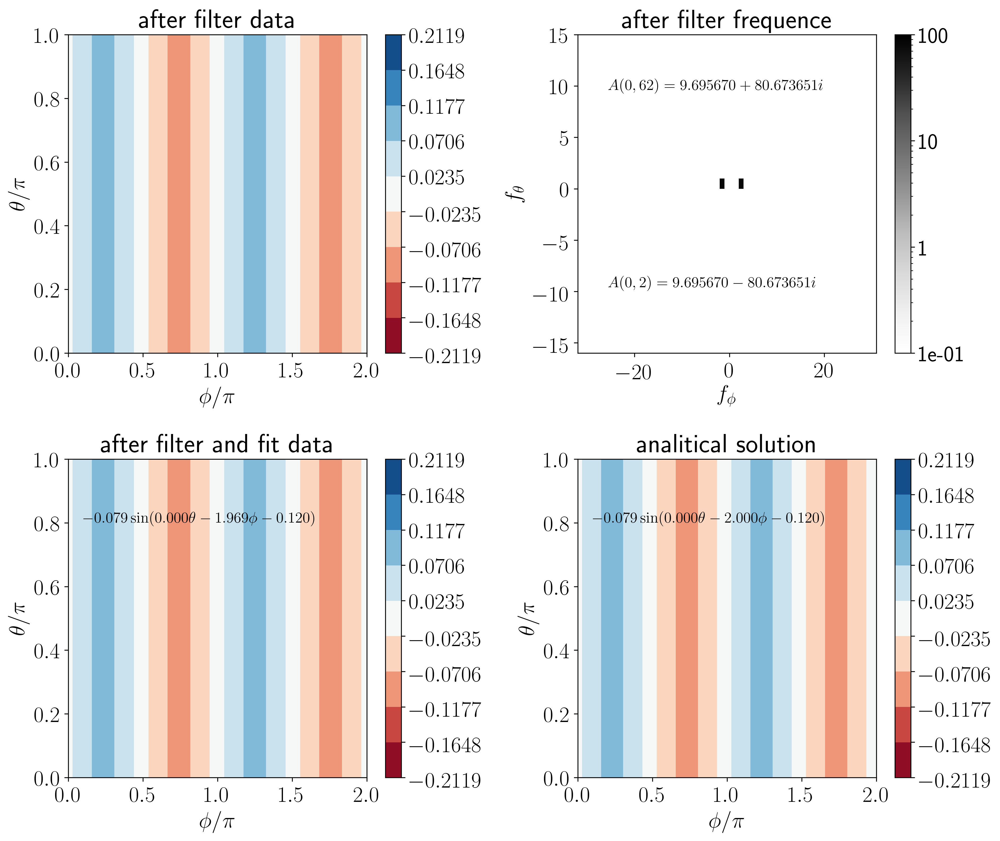

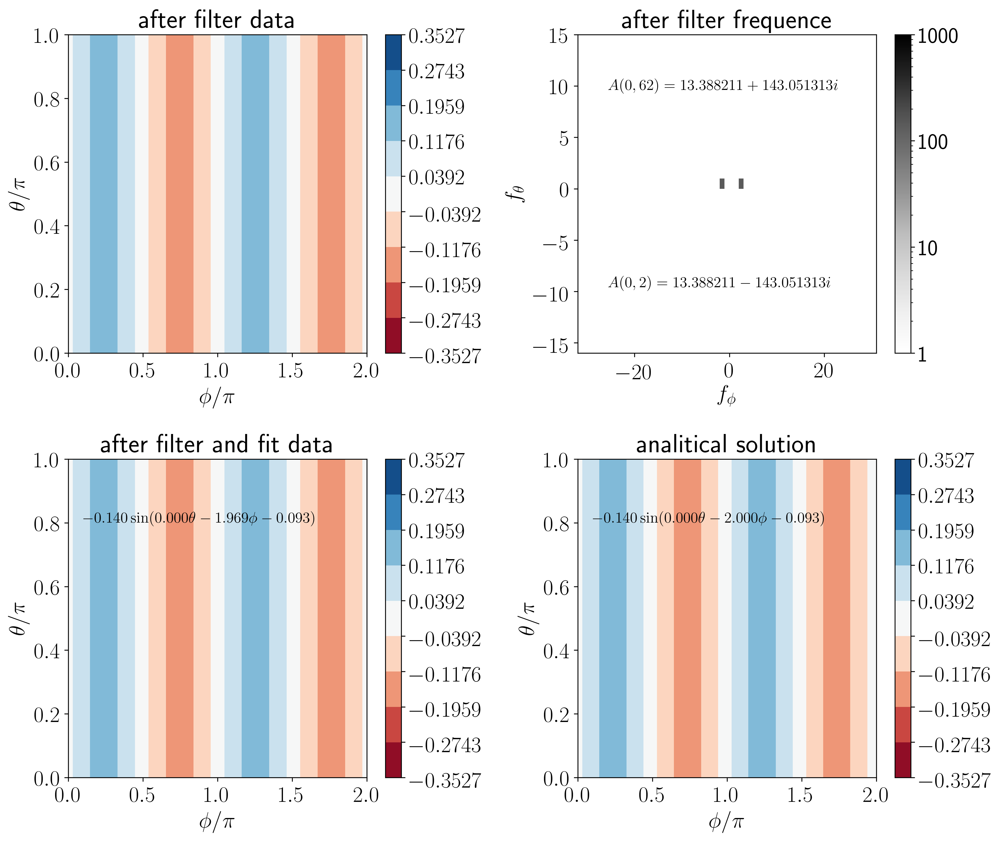

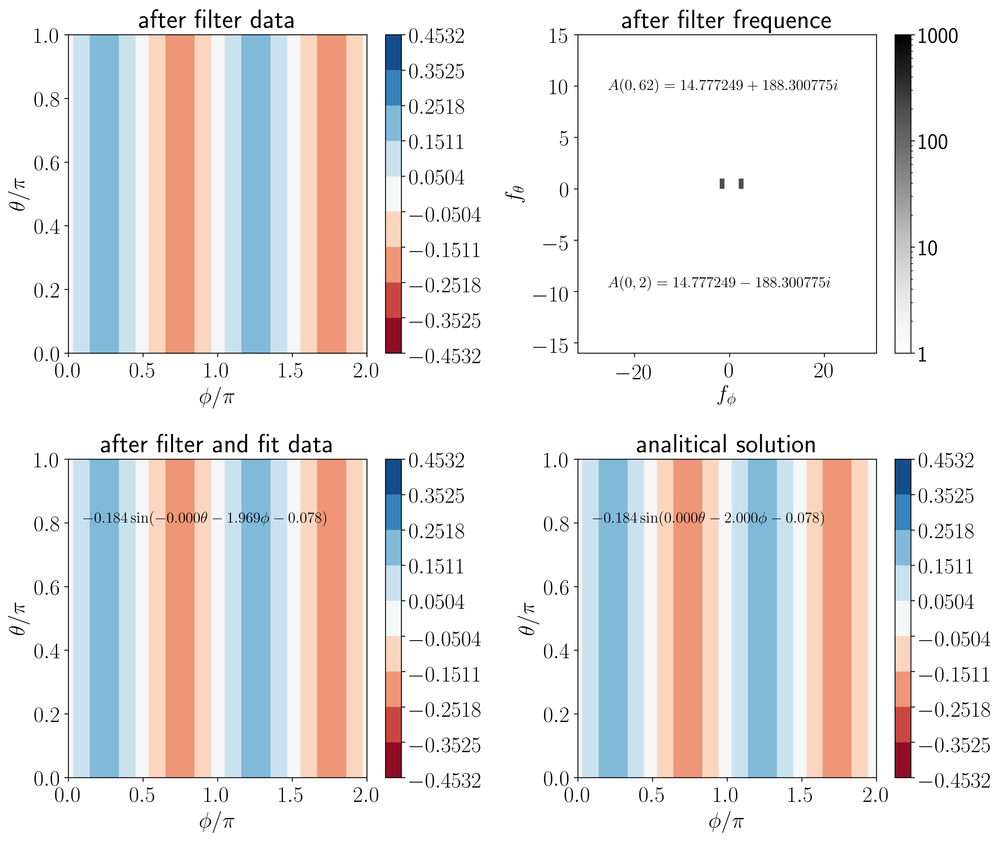

In [7]:
# 2D fft of Wx, Wy, Wz, investigate Amp and \alpha as function of \psi
importlib.reload(spf_tb)
use_uidx = 3 # 3: wx, 4: wy, 5: wz
tktl = [0, 62]

# ((psi, ((theta, phi, ui))))
with open('%s.pickle' % fft_pickle, 'rb') as handle:
    pickle_data = pickle.load(handle)
ttheta, tphi = pickle_data[0][1][0][:2]
tpsi = np.array([ti[0] for ti in pickle_data])

for tpsi, table_psi_data in pickle_data[:]:
    tw = table_psi_data[use_uidx][2].values
    spf_tb.show_fft_fit(tw, tktl, ttheta, tphi)

## Full 3D FFT version

In [384]:
fft_pickle = 'ecoC01B05_tau1_wm0_b'

In [385]:
# do 3D IFFT myself and compare with numpy version
importlib.reload(spf_tb)
use_idx_max = 6
use_uidx = 5 # 3: wx, 4: wy, 5: wz

# ((psi, ((theta, phi, ui), )))
with open('%s.pickle' % fft_pickle, 'rb') as handle:
    pickle_data = pickle.load(handle)
ttheta, tphi = pickle_data[0][1][0][:2]
tpsi = np.array([ti[0] for ti in pickle_data])
U_all = [[] for i in range(6)]
for tpsi, table_psi_data in pickle_data:
    for (ty, tx, tU), Ui in zip(table_psi_data, U_all):
        Ui.append((tpsi, ty, tx, tU))
tw = np.dstack([tU.values for _, _, _, tU in U_all[use_uidx]])

tw_fft = np.fft.fftn(tw)
idx_max = np.dstack(np.unravel_index(np.argsort(np.abs(tw_fft).ravel()), tw_fft.shape))[0][::-1]
# numpy version IFFT
idx = np.zeros_like(tw_fft, dtype=bool)
for ti in idx_max[:use_idx_max]:
    idx[ti[0], ti[1], ti[2]] = 1
tw_fft2 = tw_fft * idx
tw2 = np.fft.ifftn(tw_fft2)

print()
# do IFFT myself
tw3 = np.zeros_like(tw2)
tM, tN, tO = tw_fft.shape
tm, tn, to = np.meshgrid(np.arange(tM), np.arange(tN), np.arange(tO), indexing='ij')
for tk, tl, tj in idx_max[:use_idx_max]:
    tAkl = tw_fft[tk, tl, tj]
    tw3 = tw3 + tAkl * np.exp(2 * np.pi * 1j * tm * tk / tM) / tM * \
                       np.exp(2 * np.pi * 1j * tn * tl / tN) / tN * \
                       np.exp(2 * np.pi * 1j * to * tj / tO) / tO
    print(tk, tl, tj, tAkl)
    print((np.abs(tw3.imag) / np.abs(tw3)).max())
print(np.abs(tw3 - tw2).max())


1 1 0 (2099.122594069163-5.5981210027771e-06j)
1.0
31 63 0 (2099.122594069163+5.598120985051695e-06j)
4.061635852067786e-08
31 1 0 (-1827.2186834657691-3.5884381293276077e-06j)
1.0
1 63 0 (-1827.2186834657691+3.5884381755510495e-06j)
3.761438873663267e-14
1 63 2 (560.2854005256127+191.41794598717235j)
0.9999958331702751
31 1 14 (560.2854005256124-191.41794598717235j)
1.2748898129791376e-12
8.892132003382287e-15


In [386]:
# print values of primary frequence
importlib.reload(spf_tb)
print_idx_max = 100
use_uidx = 5 # 3: wx, 4: wy, 5: wz

# ((psi, ((theta, phi, ui), )))
with open('%s.pickle' % fft_pickle, 'rb') as handle:
    pickle_data = pickle.load(handle)
ttheta, tphi = pickle_data[0][1][0][:2]
tpsi = np.array([ti[0] for ti in pickle_data])
U_all = [[] for i in range(6)]
for tpsi, table_psi_data in pickle_data:
    for (ty, tx, tU), Ui in zip(table_psi_data, U_all):
        Ui.append((tpsi, ty, tx, tU))
tw = np.dstack([tU.values for _, _, _, tU in U_all[use_uidx]])

tw_fft = np.fft.fftn(tw)
idx_max = np.dstack(np.unravel_index(np.argsort(np.abs(tw_fft).ravel()), tw_fft.shape))[0][::-1]
t1 = []
for i0, (tk, tl, tj) in enumerate(idx_max[:print_idx_max]):
    t1.append(np.abs(tw_fft[tk, tl, tj]))
    if not np.mod(i0, 2):
        print('%5d * [%d, %d, %d] ' % (i0, tk, tl, tj), tw_fft[tk, tl, tj], np.abs(tw_fft[tk, tl, tj]))
    else:
        print('        [%d, %d, %d] ' % (tk, tl, tj), tw_fft[tk, tl, tj], np.abs(tw_fft[tk, tl, tj]))


    0 * [1, 1, 0]  (2099.122594069163-5.5981210027771e-06j) 2099.122594069163
        [31, 63, 0]  (2099.122594069163+5.598120985051695e-06j) 2099.122594069163
    2 * [31, 1, 0]  (-1827.2186834657691-3.5884381293276077e-06j) 1827.2186834657691
        [1, 63, 0]  (-1827.2186834657691+3.5884381755510495e-06j) 1827.2186834657691
    4 * [1, 63, 2]  (560.2854005256127+191.41794598717235j) 592.0815485117689
        [31, 1, 14]  (560.2854005256124-191.41794598717235j) 592.0815485117688
    6 * [31, 1, 2]  (560.2853940215208+191.41792073134854j) 592.0815341918405
        [1, 63, 14]  (560.2853940215208-191.41792073134854j) 592.0815341918405
    8 * [31, 63, 2]  (-496.4064319219047-321.2736806311276j) 591.300366581747
        [1, 1, 14]  (-496.4064319219047+321.2736806311275j) 591.300366581747
   10 * [1, 1, 2]  (-496.40643828187825-321.27367065113106j) 591.3003664985772
        [31, 63, 14]  (-496.40643828187825+321.273670651131j) 591.3003664985771
   12 * [0, 63, 14]  (235.2128439364814+48

(-1, 50)

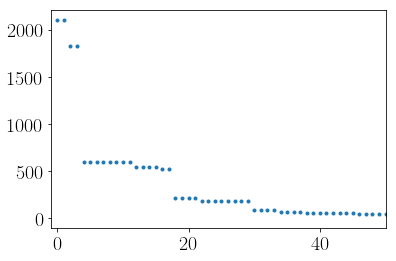

In [388]:
tktltj_list3 = ([0, 0, 0], [1, 1, 0], [31, 1, 0], [1, 63, 2], [31, 1, 2], [31, 63, 2], [1, 1, 2], [0, 63, 14], 
                [0, 63, 2], [0, 63, 0], [30, 63, 0], [30, 1, 0], [30, 63, 14])

t1 = [np.abs(tw_fft[tk, tl, tj]) for tk, tl, tj in idx_max]
plt.plot(t1, '.')
plt.xlim(-1, 50)
# plt.ylim(10, 100)

use frequence 20306.988153+0.000000i at (0, 0, 0)
use frequence pairs 5887.066707+0.000027i and 5887.066707-0.000027i at (31, 0, 0) and (1, 0, 0)
use frequence pairs -1962.094861-0.000002i and -1962.094861+0.000002i at (0, 62, 0) and (0, 2, 0)
use frequence pairs 1149.590231+556.092067i and 1149.590231-556.092067i at (0, 0, 2) and (0, 0, 14)
use frequence pairs 1213.985127-0.000005i and 1213.985127+0.000005i at (1, 62, 0) and (31, 2, 0)
use frequence pairs 748.070025+0.000013i and 748.070025-0.000013i at (31, 62, 0) and (1, 2, 0)
use frequence pairs -577.867348+279.478401i and -577.867348-279.478401i at (0, 62, 14) and (0, 2, 2)
use frequence pairs -574.878888-278.084729i and -574.878888+278.084729i at (1, 0, 2) and (31, 0, 14)
use frequence pairs -574.878872-278.084716i and -574.878872+278.084716i at (31, 0, 2) and (1, 0, 14)
use frequence pairs -572.070998+276.770415i and -572.070998-276.770415i at (0, 2, 14) and (0, 62, 2)
use frequence pairs 142.418279+329.463790i and 142.418279-32

True

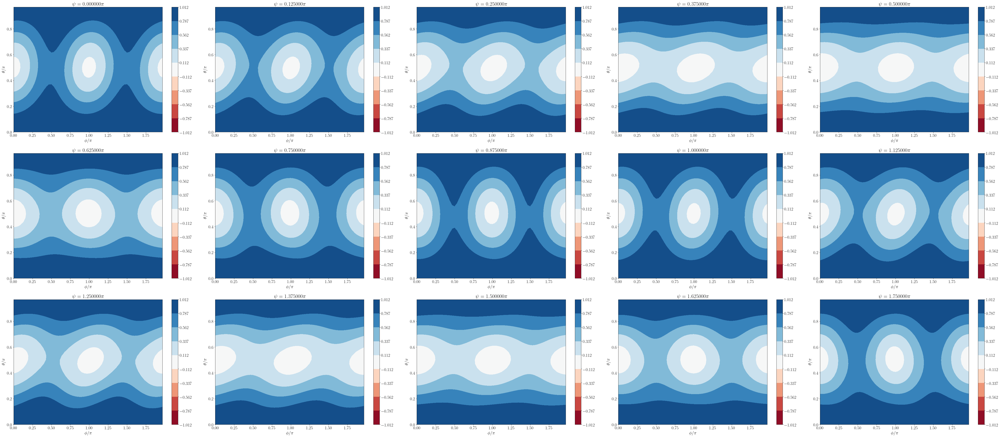

In [390]:
importlib.reload(spf_tb)
use_uidx = 4 # 3: wx, 4: wy, 5: wz
tktltj_list1 = ([0, 0, 0], [0, 62, 0], [1, 62, 0], [31, 62, 0], [0, 62, 14], [0, 2, 14], [1, 0, 0], [31, 0, 2], 
                [31, 0, 14], [31, 62, 2], [31, 2, 14], [1, 2, 2], [31, 2, 2])
tktltj_list2 = ([0, 0, 0], [31, 0, 0], [0, 62, 0], [0, 0, 2], [1, 62, 0], [31, 62, 0], [0, 62, 14], [1, 0, 2], 
                [31, 0, 2], [0, 2, 14], [31, 62, 2], [31, 2, 14], [1, 2, 2])
tktltj_list3 = ([0, 0, 0], [1, 1, 0], [31, 1, 0], [1, 63, 2], [31, 1, 2], [31, 63, 2], [1, 1, 2], [0, 63, 14], 
                [0, 63, 2], [0, 63, 0], [30, 63, 0], [30, 1, 0], [30, 63, 14])
tktltj_list = [tktltj_list1, tktltj_list2, tktltj_list3][use_uidx - 3]
# tktltj_list = ([0, 62, 0], [1, 62, 0] )
# ((psi, ((theta, phi, ui), )))
with open('%s.pickle' % fft_pickle, 'rb') as handle:
    pickle_data = pickle.load(handle)
ttheta_all, tphi_all = pickle_data[0][1][0][:2]
tpsi_all = np.array([ti[0] for ti in pickle_data])
U_all = [[] for i in range(6)]
for _, table_psi_data in pickle_data:
    for (_, _, tU), Ui in zip(table_psi_data, U_all):
        Ui.append(tU)
tw = np.dstack(U_all[use_uidx])

# tw_fft, tw2, tw_fft2 = spf_tb.do_3dfft_major_conj(tw, tktltj_list)
tw_fft, tw2, tw_fft2 = spf_tb.do_3dfft_major(tw, tktltj_list)
# spf_tb.show_ui_psi(tw, ttheta_all, tphi_all, tpsi_all)
spf_tb.show_ui_psi(tw2, ttheta_all, tphi_all, tpsi_all)

In [393]:
tw2[0, 0, 0]

0.946965332289727

In [313]:
# export frequence dates to mathematica
importlib.reload(spf_tb)

# ((psi, ((theta, phi, ui), )))
with open('%s.pickle' % fft_pickle, 'rb') as handle:
    pickle_data = pickle.load(handle)
ttheta_all, tphi_all = pickle_data[0][1][0][:2]
tpsi_all = np.array([ti[0] for ti in pickle_data])
U_all = [[] for i in range(6)]
for _, table_psi_data in pickle_data:
    for (_, _, tU), Ui in zip(table_psi_data, U_all):
        Ui.append(tU)

for i0 in (3, 4, 5):
    tw = np.dstack(U_all[i0])
    tw_fft = np.fft.fftn(tw)
    tname = '%s_w%d_fft.mat' % (fft_pickle, i0 - 2)
    savemat(tname, {'tw_fft': np.moveaxis(tw_fft[:, :, :], 0, -1)})
    print()
    print('save fft data of %dth component to %s. ' % (i0, tname))
    
#     print(tw_fft[0, 0, 0])
    tw_fft[0, 0, 0] = 0
    idx_max = np.dstack(np.unravel_index(np.argsort(np.abs(tw_fft).ravel()), tw_fft.shape))[0][::-1]
    use_idx_list1 = idx_max[0::2]
    use_idx_list2 = idx_max[1::2]
    t1 = np.hstack([tw_fft[tk, tl, tj] for tk, tl, tj in use_idx_list1])
    t2 = np.hstack([tw_fft[tk, tl, tj] for tk, tl, tj in use_idx_list2])
    tidx = np.argwhere(np.logical_not(np.isclose(t1, np.conj(t2))))
    tname = '%s_w%d_fft_idx.mat' % (fft_pickle, i0 - 2)
    savemat(tname, {'use_idx_list': use_idx_list1})
    print('save major index of fft data of %dth component to %s, unmatched case: ' % (i0, tname))
    for i0 in tidx[:1]:
        print('%5d: %3d, %3d, %3d, %15.5e, %15.5e' % (i0, use_idx_list1[i0, 0], use_idx_list1[i0, 1], use_idx_list1[i0, 2], 
                                                      np.real(t1[i0]), np.imag(t1[i0])))
        print('       %3d, %3d, %3d, %15.5e, %15.5e' % (use_idx_list2[i0, 0], use_idx_list2[i0, 1], use_idx_list2[i0, 2], 
                                         np.real(t2[i0]), np.imag(t2[i0])))



save fft data of 3th component to ecoC01B05_tau1_wm0_b_w1_fft.mat. 
save major index of fft data of 3th component to ecoC01B05_tau1_wm0_b_w1_fft_idx.mat, unmatched case: 
   55:  16,   0,   0,    -6.11482e+00,     0.00000e+00
         0,  62,  13,    -5.54428e+00,    -8.52658e-01

save fft data of 4th component to ecoC01B05_tau1_wm0_b_w2_fft.mat. 
save major index of fft data of 4th component to ecoC01B05_tau1_wm0_b_w2_fft_idx.mat, unmatched case: 
  413:   0,   0,   8,     5.86906e-03,     0.00000e+00
         1,   6,   6,    -2.25110e-03,     5.35876e-03

save fft data of 5th component to ecoC01B05_tau1_wm0_b_w3_fft.mat. 
save major index of fft data of 5th component to ecoC01B05_tau1_wm0_b_w3_fft_idx.mat, unmatched case: 


In [ ]:
# chech the conjunction pairs of FFT of rotation velocity. 
idx_max = np.dstack(np.unravel_index(np.argsort(np.abs(tw_fft).ravel()), tw_fft.shape))[0][::-1]
use_idx_list1 = idx_max[0::2]
use_idx_list2 = idx_max[1::2]
t1 = np.hstack([tw_fft[tk, tl, tj] for tk, tl, tj in use_idx_list1])
t2 = np.hstack([tw_fft[tk, tl, tj] for tk, tl, tj in use_idx_list2])
tidx = np.argwhere(np.logical_not(np.isclose(t1, np.conj(t2))))
for i0 in range(10):
    tk1, tl1, tj1 = use_idx_list1[i0]
    tk2 = tM - tk1 if tk1 > 0 else tk1
    tl2 = tN - tl1 if tl1 > 0 else tl1
    tj2 = tO - tj1 if tj1 > 0 else tj1
    print('%5d: %3d, %3d, %3d, %15.5e, %15.5e' % (i0, tk1, tl1, tj1, 
                                                  np.real(t1[i0]), np.imag(t1[i0])))
    print('       %3d, %3d, %3d, %15.5e, %15.5e' % (tk2, tl2, tj2, 
                                                    np.real(t1[i0]), np.imag(t1[i0])))
    print('       %3d, %3d, %3d, %15.5e, %15.5e' % (use_idx_list2[i0, 0], use_idx_list2[i0, 1], use_idx_list2[i0, 2], 
                                                    np.real(t2[i0]), np.imag(t2[i0])))


In [405]:
from sympy.parsing import mathematica
import sympy
from sympy.printing.latex import LatexPrinter, print_latex
from sympy.utilities.lambdify import lambdify, lambdastr
import inspect

def mm2py(mm_string, sym_list, modules):
    t12 = mathematica.mathematica(mm_string.replace('*^', '*10^'))
    t13 = sympy.lambdify(sym_list, t12, modules=modules)
    return t13

sym_list = (sympy.Symbol('theta'), sympy.Symbol('phi'), sympy.Symbol('psi'))
modules = ['numpy', ]
tw1_apx = '-0.0001866096570410253 + (-1.7029153048081684*^-6*Cos[62*phi] - 1960.88611819068*Sin[62*phi])/16384 + (279.32173923353105*Cos[2*phi + 2*psi] + 577.5209169432512*Sin[2*phi + 2*psi])/16384 + (-276.61411203034004*Cos[62*phi + 2*psi] - 571.7247600604117*Sin[62*phi + 2*psi])/16384 + (-6.114817144105495*Cos[2*theta] + 382.9878449974278*Sin[2*theta])/16384 + (-342.6737383563244*Cos[2*psi + 2*theta] + 166.50007489335445*Sin[2*psi + 2*theta])/16384 + (-326.49299534579876*Cos[2*phi + 2*psi + 2*theta] - 136.54707368952933*Sin[2*phi + 2*psi + 2*theta])/16384 + (-4.588689623494809*^-6*Cos[2*phi + 62*theta] - 1213.5905914763723*Sin[2*phi + 62*theta])/16384 + (0.000012727231708422586*Cos[62*phi + 62*theta] + 747.848109951239*Sin[62*phi + 62*theta])/16384 + (342.67373891716625*Cos[2*psi + 62*theta] - 166.5000738452281*Sin[2*psi + 62*theta])/16384 + (94.47535863228539*Cos[2*phi + 2*psi + 62*theta] - 339.70890817594295*Sin[2*phi + 2*psi + 62*theta])/16384 + (329.20060461853905*Cos[62*phi + 2*psi + 62*theta] + 142.34323812113675*Sin[62*phi + 2*psi + 62*theta])/16384 + (-91.76774684966742*Cos[2*phi + 14*psi + 62*theta] - 345.5050691031397*Sin[2*phi + 14*psi + 62*theta])/16384'
tw2_apx = '0.6197200974539849 + (-1962.0948612095603*Cos[62*phi] + 1.707528116724706*^-6*Sin[62*phi])/16384 + (1149.590231471158*Cos[14*psi] + 556.0920670954531*Sin[14*psi])/16384 + (-577.8673478225172*Cos[2*phi + 2*psi] + 279.47840108665457*Sin[2*phi + 2*psi])/16384 + (-572.0709983620775*Cos[62*phi + 2*psi] + 276.77041538443757*Sin[62*phi + 2*psi])/16384 + (5887.066706999647*Cos[62*theta] - 0.000026515346007727203*Sin[62*theta])/16384 + (136.62192184194265*Cos[2*phi + 2*psi + 2*theta] - 326.75582207414834*Sin[2*phi + 2*psi + 2*theta])/16384 + (-574.8788716391416*Cos[14*psi + 2*theta] - 278.08471606050534*Sin[14*psi + 2*theta])/16384 + (1213.9851268953007*Cos[2*phi + 62*theta] - 4.571595740233921*^-6*Sin[2*phi + 62*theta])/16384 + (748.0700251351213*Cos[62*phi + 62*theta] - 0.000012726440764286632*Sin[62*phi + 62*theta])/16384 + (142.4182788688823*Cos[62*phi + 2*psi + 62*theta] - 329.463789838122*Sin[62*phi + 2*psi + 62*theta])/16384 + (-574.8788879671743*Cos[14*psi + 62*theta] - 278.0847288505968*Sin[14*psi + 62*theta])/16384 + (345.6246033372179*Cos[2*phi + 14*psi + 62*theta] - 91.95740219001547*Sin[2*phi + 14*psi + 62*theta])/16384'
tw3_apx = '1.9074525687068844*^-16 + (518.7366380862838*Cos[63*phi] - 4.1392973060100844*^-6*Sin[63*phi])/16384 + (235.2128422040162*Cos[63*phi + 2*psi] + 486.31273548670134*Sin[63*phi + 2*psi])/16384 + (235.2128439364814*Cos[63*phi + 14*psi] - 486.3127504338104*Sin[63*phi + 14*psi])/16384 + (2099.122594069163*Cos[phi + 2*theta] + 5.5981210027771*^-6*Sin[phi + 2*theta])/16384 + (-496.40643828187825*Cos[phi + 2*psi + 2*theta] + 321.27367065113106*Sin[phi + 2*psi + 2*theta])/16384 + (560.2854005256127*Cos[63*phi + 2*psi + 2*theta] - 191.41794598717235*Sin[63*phi + 2*psi + 2*theta])/16384 + (-213.32024088220518*Cos[phi + 60*theta] - 5.69643947721086*^-6*Sin[phi + 60*theta])/16384 + (-213.45250720383183*Cos[63*phi + 60*theta] - 5.6899100784152866*^-6*Sin[63*phi + 60*theta])/16384 + (-79.60775091498382*Cos[63*phi + 14*psi + 60*theta] + 164.03928821590327*Sin[63*phi + 14*psi + 60*theta])/16384 + (-1827.2186834657691*Cos[phi + 62*theta] + 3.5884381293276077*^-6*Sin[phi + 62*theta])/16384 + (560.2853940215208*Cos[phi + 2*psi + 62*theta] - 191.41792073134854*Sin[phi + 2*psi + 62*theta])/16384 + (-496.4064319219047*Cos[63*phi + 2*psi + 62*theta] + 321.2736806311276*Sin[63*phi + 2*psi + 62*theta])/16384'

fun_w1_apx = lambda theta, phi, psi: mm2py(tw1_apx, sym_list, modules)(theta, phi, psi)
fun_w2_apx = lambda theta, phi, psi: mm2py(tw2_apx, sym_list, modules)(theta, phi, psi)
fun_w3_apx = lambda theta, phi, psi: mm2py(tw3_apx, sym_list, modules)(theta, phi, psi)

In [406]:
importlib.reload(spf_tb)
ttheta_all = np.linspace(0, np.pi, 33)
tphi_all = np.linspace(0, 2 * np.pi, 65)
tpsi_all = np.linspace(0, 2 * np.pi, 16, endpoint=False)

tw1 = np.dstack([fun_w1_apx(*np.meshgrid(ttheta_all, tphi_all, indexing='ij'), tpsi) for tpsi in tpsi_all])
tw2 = np.dstack([fun_w2_apx(*np.meshgrid(ttheta_all, tphi_all, indexing='ij'), tpsi) for tpsi in tpsi_all])
tw3 = np.dstack([fun_w3_apx(*np.meshgrid(ttheta_all, tphi_all, indexing='ij'), tpsi) for tpsi in tpsi_all])

True

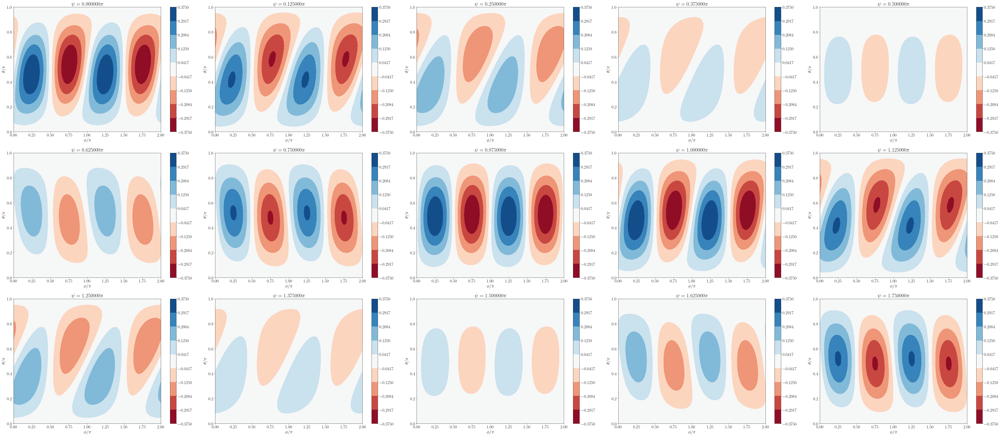

In [402]:
spf_tb.show_ui_psi(tw1, ttheta_all, tphi_all, tpsi_all)

True

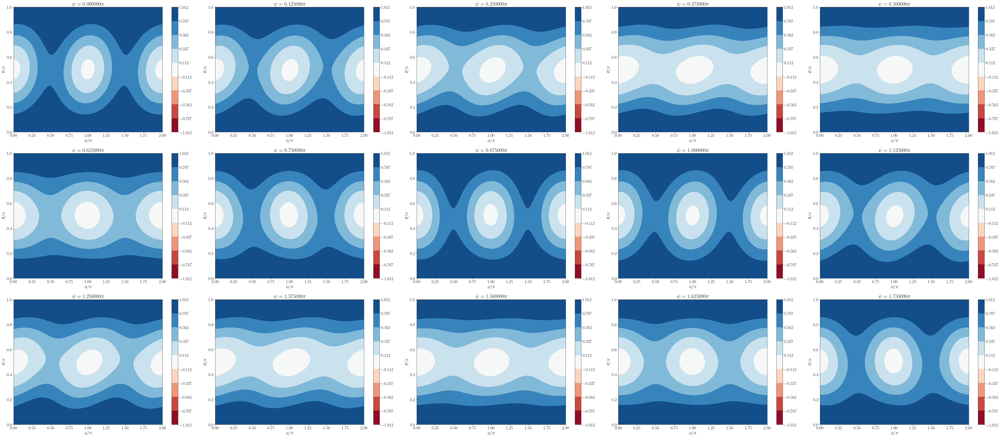

In [403]:
spf_tb.show_ui_psi(tw2, ttheta_all, tphi_all, tpsi_all)

True

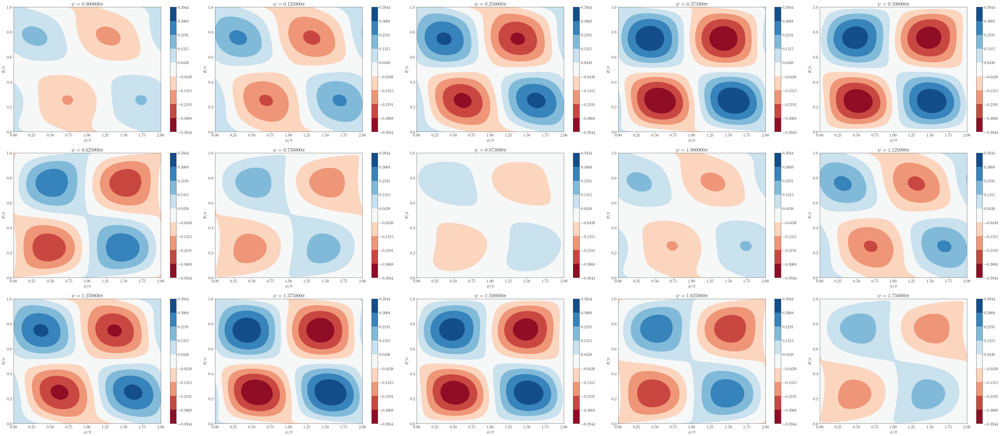

In [404]:
spf_tb.show_ui_psi(tw3, ttheta_all, tphi_all, tpsi_all)

In [419]:
sym_list = (sympy.Symbol('z'), sympy.Symbol('th0'), sympy.Symbol('ph0'), sympy.Symbol('ps0'), 
            sympy.Symbol('c01'), sympy.Symbol('c02'), sympy.Symbol('c03'))
modules = ['numpy', ]

theta_apx = 'th0 - 0.6197200974539849*c01*z*Cos[ph0] + 0.000036887909511729156*c01*z*Cos[61*ph0] + 0.11971987852173585*c01*z*Cos[63*ph0] - 0.1796590181579482*c01*z*Cos[ph0 - 62*th0] - 0.21669486384509337*c01*z*Cos[ph0 + 62*th0] + 0.03703584568714515*c01*z*Cos[3*ph0 + 62*th0] - 0.0001866096570410253*c01*z*Sin[ph0] - 1.4077184803886813*^-13*c01*z*Sin[61*ph0] - 1.0407847355752181*^-10*c01*z*Sin[63*ph0] - 8.091841433022218*^-10*c01*z*Sin[ph0 - 62*th0] + 9.492198373786016*^-10*c01*z*Sin[ph0 + 62*th0] - 1.4003569407637966*^-10*c01*z*Sin[3*ph0 + 62*th0]'
fun_theta_apx = lambda theta, phi, psi: mm2py(theta_apx, sym_list, modules)(theta, phi, psi)

In [423]:
# mm2py(theta_apx, sym_list, modules)
mm2py(theta_apx, sym_list, modules)(1, 1, 1, 1, -1, -1, -1)

1.4050707199171542

## Obtain the third rank tensors of Risistant Matrix from the simulation results of passive microswimmer locomotion in shear flow.  

In [635]:
importlib.reload(spf_tb)
use_uidx = 4 # 3: wx, 4: wy, 5: wz
with open('%s.pickle' % fft_pickle, 'rb') as handle:
    pickle_data = pickle.load(handle)
ttheta_all, tphi_all = pickle_data[0][1][0][:2]
if tphi_all[-1] < (2 * np.pi):
    tphi_all = np.hstack((tphi_all, 2 * np.pi))
if ttheta_all[-1] < (np.pi):
    ttheta_all = np.hstack((ttheta_all, np.pi))
tpsi_all = np.array([ti[0] for ti in pickle_data])
U_all = [[] for i in range(6)]
for _, table_psi_data in pickle_data:
    for (ttheta, tphi, tU), Ui in zip(table_psi_data, U_all):
        if tphi[-1] < (2 * np.pi):
            tU[2 * np.pi] = tU[0]
        if ttheta[-1] < (np.pi):
            tU = tU.append(tU.loc[0].rename(np.pi))
        Ui.append(tU)
tw = np.dstack(U_all[use_uidx])
# spf_tb.show_ui_psi(tw, ttheta_all, tphi_all, tpsi_all)

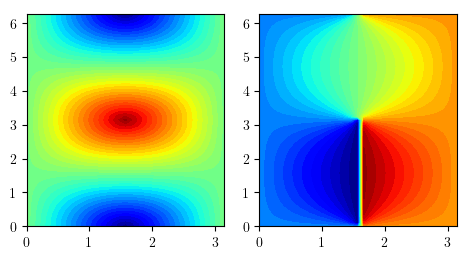

In [725]:
th2, ph2 = np.meshgrid(ttheta_all, tphi_all, indexing='ij')
p2 = np.dstack((np.sin(th2) * np.cos(ph2), np.sin(th2) * np.sin(ph2), np.cos(th2)))
p21 = np.dstack((p2[..., 1], p2[..., 2], p2[..., 0]))
th21 = np.arccos(p21[..., 2])
ph21 = np.arctan2(p21[..., 1], p21[..., 0])
ph21[ph21 < 0] = ph21[ph21 < 0] + 2 * np.pi

%matplotlib inline
figsize = np.array((16, 9)) * 0.3
dpi = 100

fig, axs = plt.subplots(1, 2, figsize=figsize, dpi=dpi)
fig.patch.set_facecolor('white')
axi = axs[0]
axi.contourf(th2, ph2, th21, 50, cmap = plt.get_cmap('jet'))
axi = axs[1]
axi.contourf(th2, ph2, ph21, 50, cmap = plt.get_cmap('jet'))
fig.tight_layout()

# fig, axs = plt.subplots(1, 2, figsize=figsize, dpi=dpi)
# fig.patch.set_facecolor('white')
# axi = axs[0]
# axi.contourf(th2, ph2, tw[..., 0], 50, cmap = plt.get_cmap('jet'))
# axi = axs[1]
# axi.contourf(th21, ph21, tw[..., 0], 50, cmap = plt.get_cmap('jet'))
# fig.tight_layout()

In [707]:
np.hstack((p_map, np.array(p_map) + 3)) % 3

array([1, 0, 2, 1, 0, 2])

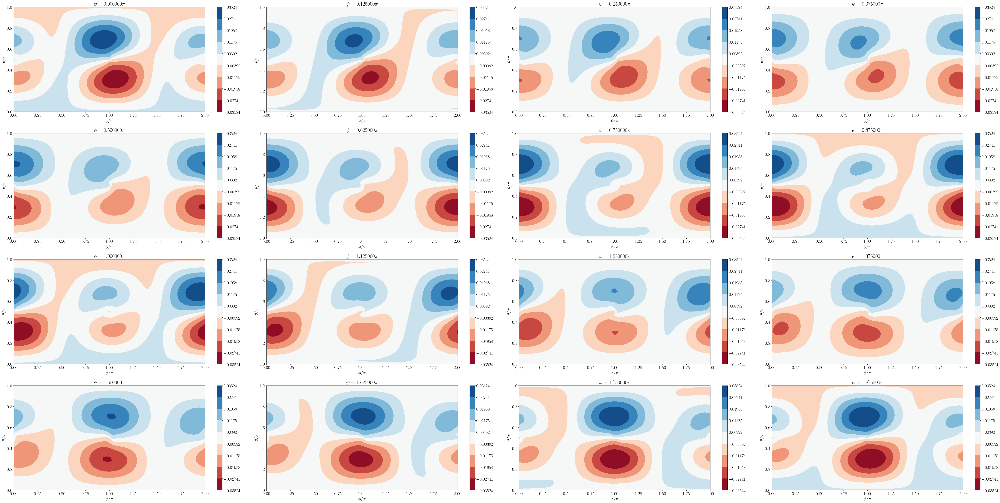

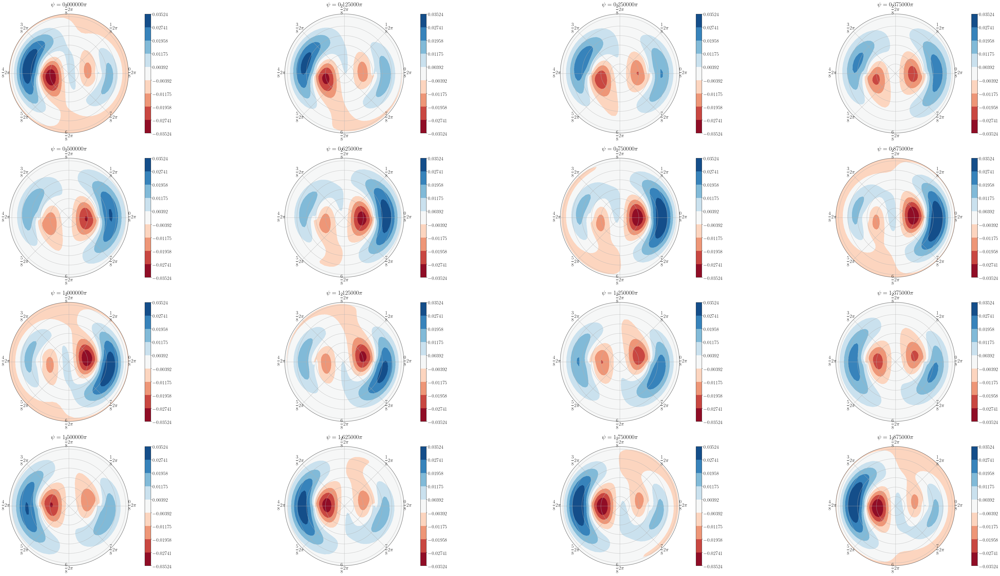

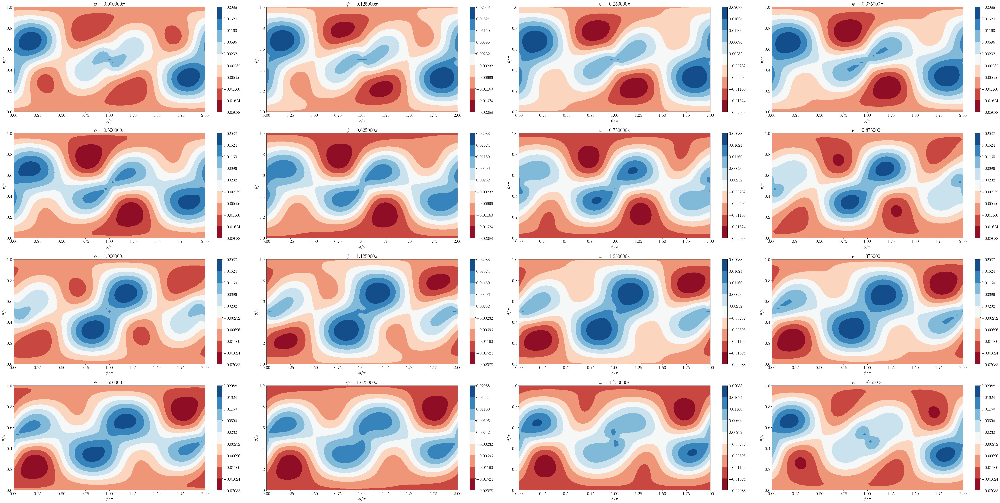

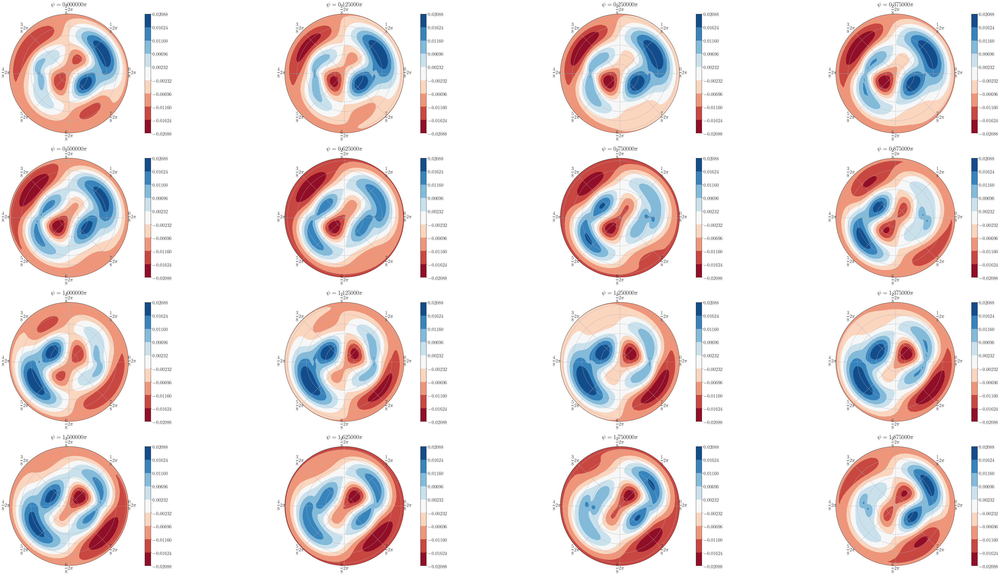

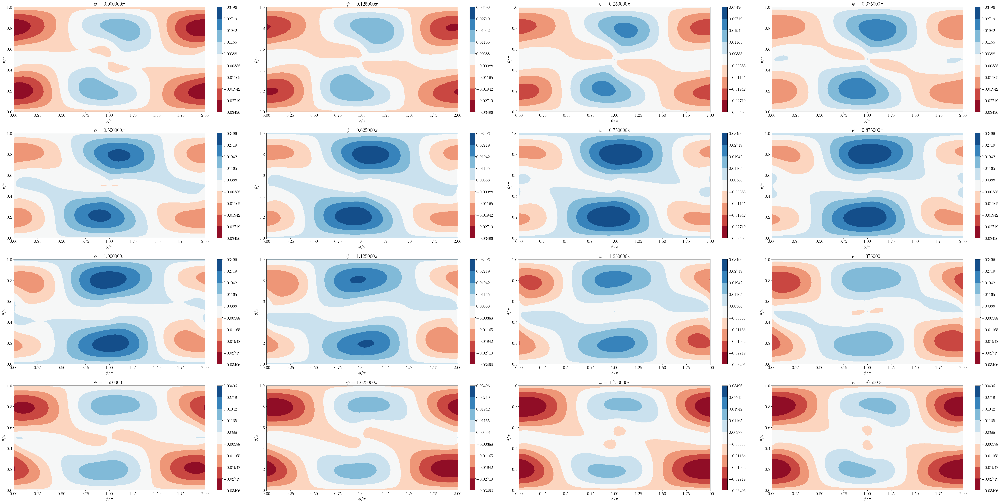

...

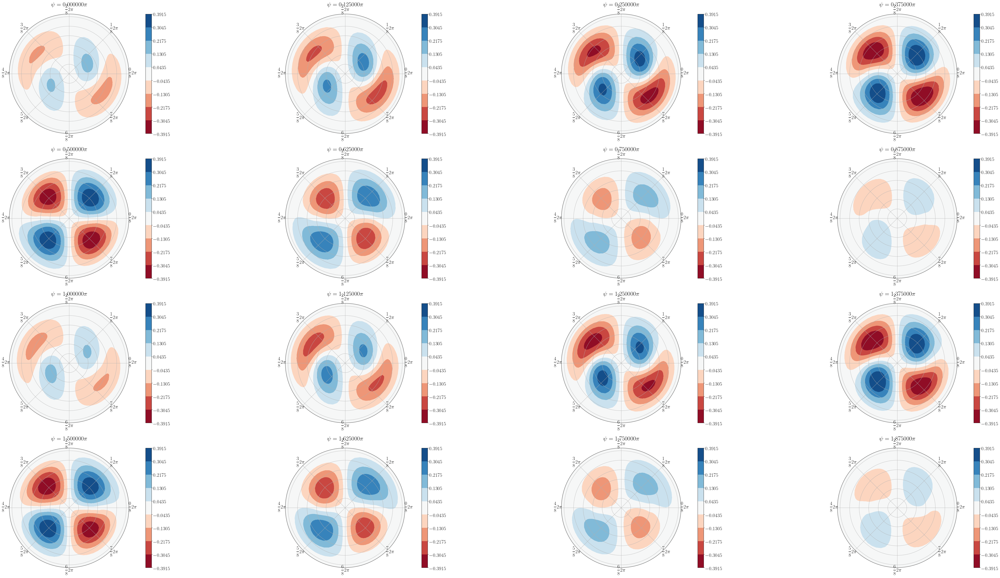

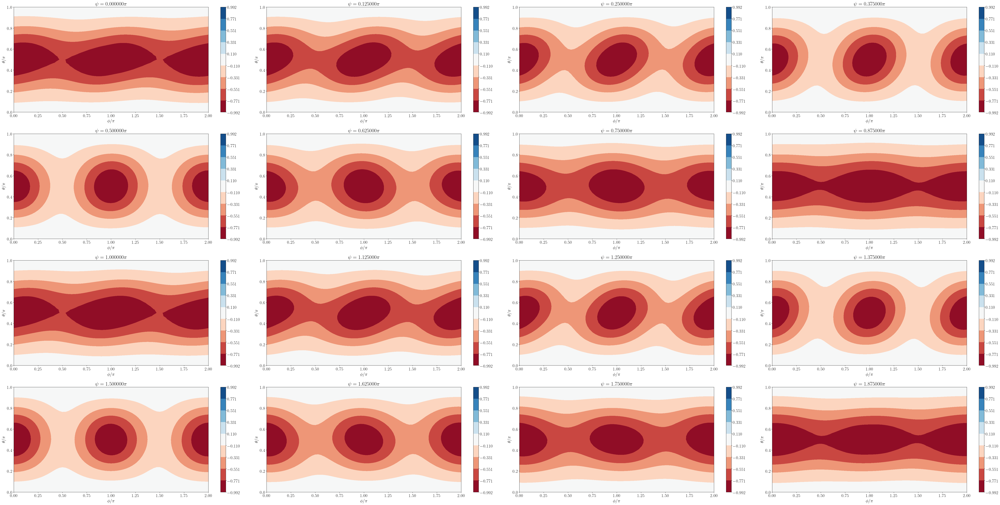

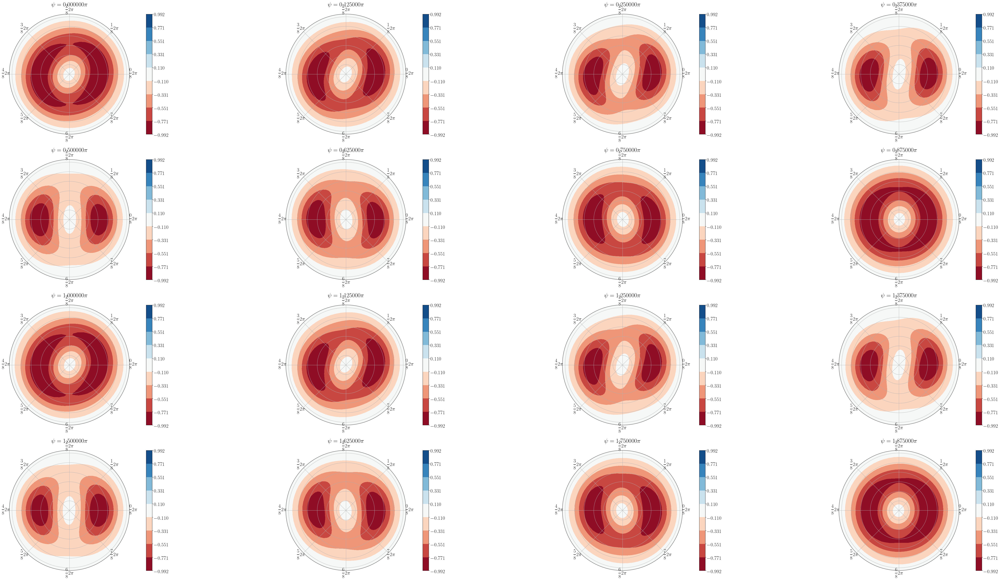

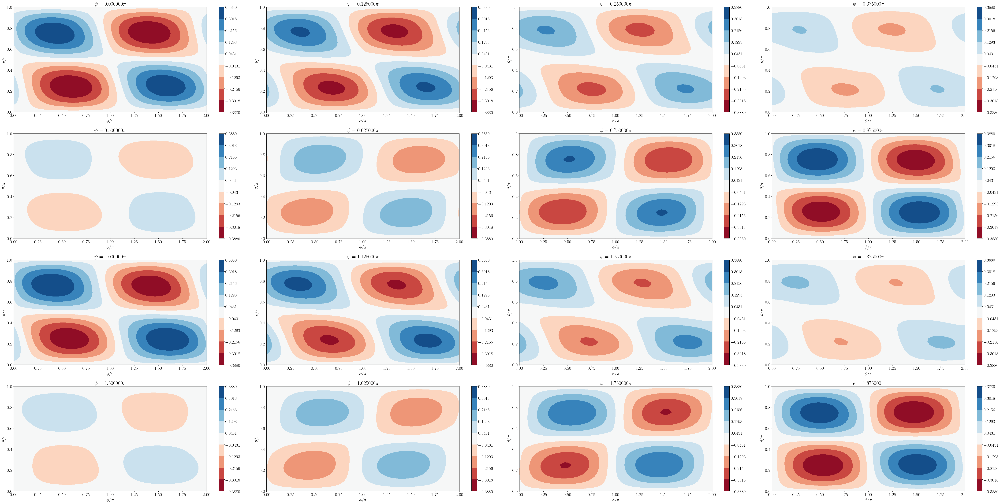

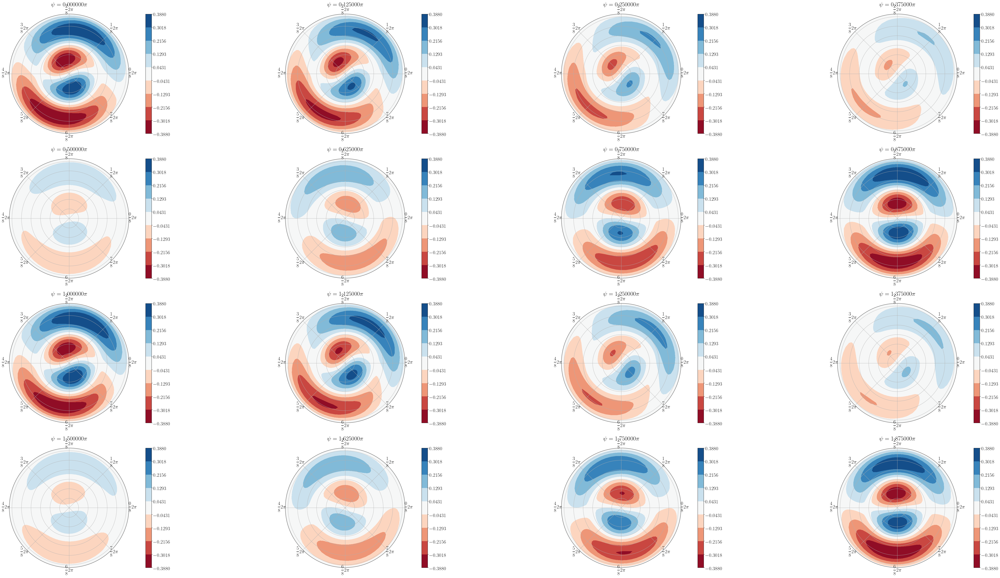

In [724]:
# p_map = [0, 2, 1]
# p_sign = [1, -1, 1]
# rot_psi = np.pi / 2

# p_map = [0, 1, 2]
# p_sign = [1, 1, 1]
# rot_psi = 0

# p_map = [1, 2, 0]
# p_sign = [1, 1, 1]
# rot_psi = np.pi

# p_map = [1, 0, 2]
# p_sign = [-1, 1, 1]
# rot_psi = np.pi / 2

p_map = [2, 1, 0]
p_sign = [1, -1, 1]
rot_psi = np.pi

# p_map = [2, 0, 1]
# p_sign = [1, 1, 1]
# rot_psi = np.pi / 2
figsize = np.array((16, 9)) * 0.9
dpi = 100

th2, ph2 = np.meshgrid(ttheta_all, tphi_all, indexing='ij')
p2 = np.dstack((np.sin(th2) * np.cos(ph2), np.sin(th2) * np.sin(ph2), np.cos(th2)))
p21 = np.dstack((p_sign[0] * p2[..., p_map[0]], p_sign[1] * p2[..., p_map[1]], p_sign[2] * p2[..., p_map[2]]))
th21 = np.arccos(p21[..., 2])
ph21 = np.arctan2(p21[..., 1], p21[..., 0])
ph21[ph21 < 0] = ph21[ph21 < 0] + 2 * np.pi

# fig, axs = plt.subplots(1, 2, figsize=figsize, dpi=dpi)
# fig.patch.set_facecolor('white')
# axi = axs[0]
# axi.contourf(th2, ph2, th21, 50, cmap = plt.get_cmap('jet'))
# axi = axs[1]
# axi.contourf(th2, ph2, ph21, 50, cmap = plt.get_cmap('jet'))
# fig.tight_layout()

# tpsi_all2 = (tpsi_all + rot_psi) % (2 * np.pi)
# tidx = np.argsort(tpsi_all2).astype(int)
# tpsi_all2 = tpsi_all
tidx = np.hstack((p_map, np.array(p_map) + 3))
for use_uidx in tidx: # 3: wx, 4: wy, 5: wz
    tw = p_sign[0] * p_sign[use_uidx % 3] * np.dstack(U_all[use_uidx])
    tw2 = []
    for i0 in range(tw.shape[-1]):
        intp_fun = interpolate.RectBivariateSpline(ttheta_all, tphi_all, tw[..., i0], kx=3, ky=3)
        tw2i = np.hstack([intp_fun(t1, t2) for t1, t2 in zip(th21.ravel(), ph21.ravel())]).reshape(th21.shape)
        tw2.append(tw2i)  
    tw2 = np.dstack(tw2)
    spf_tb.show_ui_psi(tw2, ttheta_all, tphi_all, tpsi_all)
#     spf_tb.show_ui_psi(tw2, ttheta_all, tphi_all, tpsi_all, polar=True)

## obtain gijk (hijk) from ux, uy, and uz (wx, wy, and wz)

In [1108]:
importlib.reload(spf_tb)
fft_pickle = 'ecoC01B05_tau1_wm0_b'

with open('%s.pickle' % fft_pickle, 'rb') as handle:
    pickle_data = pickle.load(handle)
ttheta_all, tphi_all = pickle_data[0][1][0][:2]
tpsi_all = np.array([ti[0] for ti in pickle_data])
U_all = [[] for i in range(6)]
for _, table_psi_data in pickle_data:
    for (ttheta, tphi, tU), Ui in zip(table_psi_data, U_all):
        Ui.append(tU)
# u_all = np.vstack([np.hstack([tU.unstack().values for tU in U_all[i0]]) for i0 in range(3)]).T
# w_all = np.vstack([np.hstack([tU.unstack().values for tU in U_all[i0 + 3]]) for i0 in range(3)]).T

# idx_all = []
# for tpsi, tU in zip(tpsi_all, U_all[0]):
#     t1 = np.vstack(tU.T.unstack().index.values)
#     idx_all.append(np.hstack((t1, tpsi * np.ones(t1.shape[0]).reshape((t1.shape[0], 1)))))
# idx_all = np.vstack(idx_all)

# # u_loc_all = np.vstack([np.dot(spf_tb.Rrot(*idx_all[i0]).T, u_all[i0]) for i0 in range(idx_all.shape[0])])
# # w_loc_all = np.vstack([np.dot(spf_tb.Rrot(*idx_all[i0]).T, w_all[i0]) for i0 in range(idx_all.shape[0])])
# wb = np.array((0, 1, 0))
# w_loc_all = np.vstack([np.dot(spf_tb.Rrot(*idx_all[i0]), (w_all[i0] - wb)) for i0 in range(idx_all.shape[0])])


In [1713]:
ttheta_all

array([0.        , 0.09817477, 0.19634954, 0.29452431, 0.39269908,
       0.49087385, 0.58904862, 0.68722339, 0.78539816, 0.88357293,
       0.9817477 , 1.07992247, 1.17809725, 1.27627202, 1.37444679,
       1.47262156, 1.57079633, 1.6689711 , 1.76714587, 1.86532064,
       1.96349541, 2.06167018, 2.15984495, 2.25801972, 2.35619449,
       2.45436926, 2.55254403, 2.6507188 , 2.74889357, 2.84706834,
       2.94524311, 3.04341788])

In [ ]:
U_all[1][0][ttheta_all]

In [1712]:
with pd.option_context('display.max_rows', None, 'display.max_columns', None, 'display.width', None):
    display(U_all[1][0])

norm_phi,0.000000,0.098175,0.196350,0.294524,0.392699,0.490874,0.589049,0.687223,0.785398,0.883573,0.981748,1.079922,1.178097,1.276272,1.374447,1.472622,1.570796,1.668971,1.767146,1.865321,1.963495,2.061670,2.159845,2.258020,2.356194,2.454369,2.552544,2.650719,2.748894,2.847068,2.945243,3.043418,3.141593,3.239767,3.337942,3.436117,3.534292,3.632467,3.730641,3.828816,3.926991,4.025166,4.123340,4.221515,4.319690,4.417865,4.516039,4.614214,4.712389,4.810564,4.908739,5.006913,5.105088,5.203263,5.301438,5.399612,5.497787,5.595962,5.694137,5.792311,5.890486,5.988661,6.086836,6.185011
norm_theta,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0.000000,-0.008981,-0.008482,-0.008035,-0.007655,-0.007359,-0.007156,-0.007056,-0.007062,-0.007173,-0.007385,-0.007691,-0.008079,-0.008532,-0.009036,-0.009568,-0.010111,-0.010641,-0.011140,-0.011588,-0.011967,-0.012264,-0.012466,-0.012567,-0.012561,-0.012450,-0.012237,-0.011931,-0.011544,-0.011090,-0.010587,-0.010054,-0.009512,-0.008981,-0.008482,-0.008035,-0.007655,-0.007359,-0.007156,-0.007056,-0.007062,-0.007173,-0.007385,-0.007691,-0.008079,-0.008532,-0.009036,-0.009568,-0.010111,-0.010641,-0.011140,-0.011588,-0.011967,-0.012264,-0.012466,-0.012567,-0.012561,-0.012450,-0.012237,-0.011931,-0.011544,-0.011090,-0.010587,-0.010054,-0.009512
0.098175,-0.010469,-0.010185,-0.009913,-0.009663,-0.009447,-0.009271,-0.009143,-0.009067,-0.009046,-0.009082,-0.009173,-0.009314,-0.009502,-0.009729,-0.009985,-0.010262,-0.010548,-0.010832,-0.011104,-0.011354,-0.011570,-0.011746,-0.011875,-0.011950,-0.011971,-0.011935,-0.011844,-0.011702,-0.011515,-0.011288,-0.011032,-0.010755,-0.010469,-0.010185,-0.009913,-0.009663,-0.009447,-0.009271,-0.009143,-0.009067,-0.009046,-0.009082,-0.009173,-0.009314,-0.009502,-0.009729,-0.009985,-0.010262,-0.010548,-0.010832,-0.011104,-0.011354,-0.011570,-0.011746,-0.011875,-0.011950,-0.011971,-0.011935,-0.011844,-0.011702,-0.011515,-0.011288,-0.011032,-0.010755
0.196350,-0.011555,-0.011604,-0.011624,-0.011616,-0.011579,-0.011515,-0.011427,-0.011317,-0.011191,-0.011052,-0.010906,-0.010759,-0.010617,-0.010484,-0.010367,-0.010269,-0.010195,-0.010146,-0.010126,-0.010134,-0.010171,-0.010235,-0.010323,-0.010433,-0.010560,-0.010699,-0.010844,-0.010991,-0.011133,-0.011265,-0.011383,-0.011480,-0.011555,-0.011604,-0.011624,-0.011616,-0.011579,-0.011515,-0.011427,-0.011317,-0.011191,-0.011052,-0.010906,-0.010759,-0.010617,-0.010484,-0.010367,-0.010269,-0.010195,-0.010146,-0.010126,-0.010134,-0.010171,-0.010235,-0.010323,-0.010433,-0.010560,-0.010699,-0.010844,-0.010991,-0.011133,-0.011265,-0.011383,-0.011480
0.294524,-0.012199,-0.012674,-0.013081,-0.013403,-0.013630,-0.013752,-0.013764,-0.013666,-0.013461,-0.013158,-0.012768,-0.012306,-0.011790,-0.011239,-0.010676,-0.010121,-0.009596,-0.009121,-0.008714,-0.008391,-0.008165,-0.008044,-0.008032,-0.008131,-0.008335,-0.008639,-0.009028,-0.009490,-0.010006,-0.010556,-0.011119,-0.011674,-0.012199,-0.012674,-0.013081,-0.013403,-0.013630,-0.013752,-0.013764,-0.013666,-0.013461,-0.013158,-0.012768,-0.012306,-0.011790,-0.011239,-0.010676,-0.010121,-0.009596,-0.009121,-0.008714,-0.008391,-0.008165,-0.008044,-0.008032,-0.008131,-0.008335,-0.008639,-0.009028,-0.009490,-0.010006,-0.010556,-0.011119,-0.011674
0.392699,-0.012374,-0.013335,-0.014191,-0.014907,-0.015457,-0.015819,-0.015980,-0.015933,-0.015680,-0.015231,-0.014602,-0.013819,-0.012912,-0.011914,-0.010865,-0.009805,-0.008774,-0.007813,-0.006958,-0.006242,-0.005692,-0.005331,-0.005171,-0.005219,-0.005472,-0.005921,-0.006549,-0.007332,-0.008239,-0.009236,-0.010284,-0.011344,-0.012374,-0.013335,-0.014191,-0.014907,-0.015457,-0.015819,-0.015980,-0.015933,-0.015680,-0.015231,-0.014602,-0.013819,-0.012912,-0.011914,-0.010865,-0.009805,-0.008774,-0.007813,-0.006958,-0.006242,-0.005692,-0.005331,-0.005171,-0.005219,-0.005472,-0.005921,-0.006549,-0.007332,-0.008239,-0.009236,-0.010284,-0.011344
0.490874,-0.012074,-0.013542,-0.014870,-0.016008,-0.016912,-0.017547,-0.017889,-0.017925,-0.017

In [65]:
pickle_dict

{'f_nodes': array([[-0.01056457,  0.00437599,  1.71373388],
        [-0.00437599, -0.01056457,  1.71373388],
        [ 0.01056457, -0.00437599,  1.71373388],
        ...,
        [ 0.29176567,  0.07896289,  0.26545571],
        [ 0.28729325,  0.07821732,  0.26519057],
        [ 0.28692785,  0.08151299,  0.26208675]]),
 'problem_kwargs': {'MPISIZE': 24,
  'Tfct': 1,
  'basei': 1,
  'belemshandle': 'belems',
  'bnodeshandle': 'bnodes',
  'center': array([0, 0, 0]),
  'ch': 3.0,
  'dist_hs': 0.5,
  'ds': 0.023333,
  'eT': -1.0,
  'eh': -1.0,
  'es': -1.0,
  'ffweightT': 2.0,
  'ffweightx': 2.0,
  'ffweighty': 2.0,
  'ffweightz': 2.0,
  'field_range': array([[-3, -3, -3],
         [ 3,  3,  3]]),
  'fileHandle': 'ecoC01B05_baseFlow',
  'getConvergenceHistory': False,
  'hfct': 1.0,
  'int_epsabs': 1e-200,
  'int_epsrel': 1e-10,
  'int_limit': 1000,
  'left_hand': False,
  'ls': 1.0,
  'matname': 'body1',
  'matrix_method': 'pf',
  'n_grid': array([10, 10, 10]),
  'n_node_threshold': 5000,


In [64]:
pickle_name = 'ecoC01B05_baseFlow'

with open('%s.pickle' % pickle_name, 'rb') as handle:
    pickle_dict = pickle.load(handle)

# print(np.vstack(pickle_dict['uw_Base_list']).shape)
uEbase_list = np.vstack(pickle_dict['uw_Base_list'])[1:6, 0:3]
uSbase_list = np.vstack(pickle_dict['uw_Base_list'])[6:9, 0:3]
wEbase_list = np.vstack(pickle_dict['uw_Base_list'])[1:6, 3:6]
wSbase_list = np.vstack(pickle_dict['uw_Base_list'])[6:9, 3:6]
print(wEbase_list)
print()
print(wSbase_list)
print()
print(uEbase_list)
print()
print(uSbase_list)
print()
print(pickle_dict['uw_Base_list'][9])

[[-0.00628201 -0.00359604 -0.26093982]
 [-0.03146625  0.02636917  0.0252918 ]
 [ 0.00262137 -0.01267284  0.53868783]
 [-0.00136997  0.93545887  0.02544567]
 [-0.98074473 -0.02252829  0.00462777]]

[[1.00000000e+00 1.35557020e-12 3.50521297e-12]
 [2.26368026e-12 1.00000000e+00 1.20490652e-11]
 [3.08983658e-13 8.97127441e-14 1.00000000e+00]]

[[ 8.73490227e-03 -3.04951663e-04  9.22176811e-05]
 [-1.77658091e-02 -1.73520598e-02 -5.82374515e-02]
 [ 5.32147082e-03  4.78599433e-03  6.07358035e-03]
 [ 9.87611809e-03 -1.79897016e-02  1.37028527e-02]
 [ 2.13276729e-02 -6.80206271e-04  6.09546251e-03]]

[[-3.13832175e-13  7.53768232e-13 -1.37302537e-12]
 [-2.17152938e-12 -1.28505456e-11  6.11104526e-13]
 [-3.08628531e-13 -1.09422286e-13  1.34169180e-14]]

[ 6.35418425e-04 -2.19676135e-03  4.02494122e-03 -1.31786126e-03
 -1.23559401e-03 -7.57100877e-01]


In [1681]:
# # dbg code 
# pickle_name = 'ecoC01B05_baseFlow'

# with open('%s.pickle' % pickle_name, 'rb') as handle:
#     pickle_dict = pickle.load(handle)

# # print(np.vstack(pickle_dict['uw_Base_list']).shape)
# uEbase_list = np.vstack(pickle_dict['uw_Base_list'])[1:6, 0:3]
# uSbase_list = np.vstack(pickle_dict['uw_Base_list'])[6:9, 0:3]
# wEbase_list = np.vstack(pickle_dict['uw_Base_list'])[1:6, 3:6]
# wSbase_list = np.vstack(pickle_dict['uw_Base_list'])[6:9, 3:6]
# print(wEbase_list)
# print(wSbase_list)
# # print(pickle_dict['uw_Base_list'][9])

# i0, i1, i2 = np.random.randint(tpsi_all.size), np.random.randint(ttheta_all.size), np.random.randint(tphi_all.size)
# i0, i1, i2 = 5, 12, 21
# tpsi = tpsi_all[i0]
# ttheta = ttheta_all[i1]
# tphi = tphi_all[i2]

# Eij_loc = spf_tb.Eij_loc(ttheta, tphi, tpsi)
# Sij_loc = spf_tb.Sij_loc(ttheta, tphi, tpsi)
# Ebase_fct = np.array([Eij_loc[0, 0], Eij_loc[2, 2], Eij_loc[0, 1], Eij_loc[0, 2], Eij_loc[1, 2]])
# Sbase_fct = np.array([Sij_loc[2, 1], Sij_loc[0, 2], Sij_loc[1, 0]])
# wE_loc = np.sum([a * b for a, b in zip(Ebase_fct, wEbase_list)], axis=0)
# wE = np.dot(spf_tb.Rrot(ttheta, tphi, tpsi), wE_loc)
# wS_loc = np.sum([a * b for a, b in zip(Sbase_fct, wSbase_list)], axis=0)
# wS = np.dot(spf_tb.Rrot(ttheta, tphi, tpsi), wS_loc)
# wS_cal_list.append(wS)
# tw_cal = wE + wS
# tw_sim = np.hstack((U_all[3][i0].iloc[i1].iloc[i2], U_all[4][i0].iloc[i1].iloc[i2], U_all[5][i0].iloc[i1].iloc[i2]))
# print(i0, i1, i2)
# print(ttheta, tphi, tpsi)
# print(tw_sim)
# print(tw_cal)
# print(tw_sim - tw_cal)


In [1682]:
importlib.reload(spf_tb)
pickle_name = 'ecoC01B05_baseFlow'

with open('%s.pickle' % pickle_name, 'rb') as handle:
    pickle_dict = pickle.load(handle)
uEbase_list = np.vstack(pickle_dict['uw_Base_list'])[1:6, 0:3]
uSbase_list = np.vstack(pickle_dict['uw_Base_list'])[6:9, 0:3]
wEbase_list = np.vstack(pickle_dict['uw_Base_list'])[1:6, 3:6]
wSbase_list = np.vstack(pickle_dict['uw_Base_list'])[6:9, 3:6]
wE_fun = lambda theta, phi, psi: np.array((np.cos(phi)*np.sin(theta)*(np.cos(phi)*(np.cos(2*theta)*(0.01272114*np.cos(psi) + 0.002320485005*np.sin(psi)) + np.cos(theta)*(0.02524755 + 0.261018491*np.cos(psi)**2 + 0.53873059*np.cos(psi)*np.sin(psi))*np.sin(theta)) + np.sin(phi)*(-0.01272114*np.cos(theta)*np.sin(psi) + 0.269365295*np.cos(2*psi)*np.sin(theta) + np.cos(psi)*(0.002320485005*np.cos(theta) - 0.261018491*np.sin(psi)*np.sin(theta)))) + (np.cos(phi)*np.cos(psi)*np.cos(theta) - np.sin(phi)*np.sin(psi))*(np.cos(phi)*(np.cos(2*theta)*(-0.000682955*np.cos(psi) + 0.49037295500000005*np.sin(psi)) + np.cos(theta)*(-0.03147468 + 0.00628396028*np.cos(psi)**2 + 0.00261925*np.cos(psi)*np.sin(psi))*np.sin(theta)) + np.sin(phi)*(0.000682955*np.cos(theta)*np.sin(psi) + 0.001309625*np.cos(2*psi)*np.sin(theta) + np.cos(psi)*(0.49037295500000005*np.cos(theta) - 0.00628396028*np.sin(psi)*np.sin(theta)))) + (-(np.cos(psi)*np.sin(phi)) - np.cos(phi)*np.cos(theta)*np.sin(psi))*(np.cos(phi)*(np.cos(2*theta)*(0.46773080499999997*np.cos(psi) + 0.0112595912*np.sin(psi)) + np.cos(theta)*(0.026366300000000002 + 0.0035945814*np.cos(psi)**2 - 0.01267259*np.cos(psi)*np.sin(psi))*np.sin(theta)) + np.sin(phi)*(-0.467730805*np.cos(theta)*np.sin(psi) - 0.006336295*np.cos(2*psi)*np.sin(theta) + np.cos(psi)*(0.0112595912*np.cos(theta) - 0.0035945814*np.sin(psi)*np.sin(theta)))),np.sin(phi)*np.sin(theta)*(np.cos(phi)*(np.cos(2*theta)*(0.01272114*np.cos(psi) + 0.002320485005*np.sin(psi)) + np.cos(theta)*(0.02524755 + 0.261018491*np.cos(psi)**2 + 0.53873059*np.cos(psi)*np.sin(psi))*np.sin(theta)) + np.sin(phi)*(-0.01272114*np.cos(theta)*np.sin(psi) + 0.269365295*np.cos(2*psi)*np.sin(theta) + np.cos(psi)*(0.002320485005*np.cos(theta) - 0.261018491*np.sin(psi)*np.sin(theta)))) + (np.cos(psi)*np.cos(theta)*np.sin(phi) + np.cos(phi)*np.sin(psi))*(np.cos(phi)*(np.cos(2*theta)*(-0.000682955*np.cos(psi) + 0.49037295500000005*np.sin(psi)) + np.cos(theta)*(-0.03147468 + 0.00628396028*np.cos(psi)**2 + 0.00261925*np.cos(psi)*np.sin(psi))*np.sin(theta)) + np.sin(phi)*(0.000682955*np.cos(theta)*np.sin(psi) + 0.001309625*np.cos(2*psi)*np.sin(theta) + np.cos(psi)*(0.49037295500000005*np.cos(theta) - 0.00628396028*np.sin(psi)*np.sin(theta)))) + (np.cos(phi)*np.cos(psi) - np.cos(theta)*np.sin(phi)*np.sin(psi))*(np.cos(phi)*(np.cos(2*theta)*(0.46773080499999997*np.cos(psi) + 0.0112595912*np.sin(psi)) + np.cos(theta)*(0.026366300000000002 + 0.0035945814*np.cos(psi)**2 - 0.01267259*np.cos(psi)*np.sin(psi))*np.sin(theta)) + np.sin(phi)*(-0.467730805*np.cos(theta)*np.sin(psi) - 0.006336295*np.cos(2*psi)*np.sin(theta) + np.cos(psi)*(0.0112595912*np.cos(theta) - 0.0035945814*np.sin(psi)*np.sin(theta)))),np.sin(phi)*(np.cos(theta)**2*(0.002320485005*np.cos(psi) - 0.01272114*np.sin(psi)) + np.cos(theta)*(-0.47905188000000004 + 0.25804422*np.cos(2*psi) - 0.25044185480000003*np.cos(psi)*np.sin(psi))*np.sin(theta) + (-0.00155345785*np.cos(psi) + 0.00024383285000000002*np.cos(3*psi) + 0.0047391375699999995*np.sin(psi) - 0.0015971574299999997*np.sin(3*psi))*np.sin(theta)**2) + np.cos(phi)*(0.01272114*np.cos(psi)*np.cos(theta)**3 + np.cos(theta)*(0.013183150000000001 - 0.010862664995*np.cos(2*theta))*np.sin(psi) + ((0.0059712731000000005 - 0.0052883181*np.cos(2*psi))*np.cos(2*theta) + np.cos(theta)**2*(0.02524755 + 0.261018491*np.cos(psi)**2 + 0.5160884399999999*np.cos(psi)*np.sin(psi)))*np.sin(theta) + np.cos(psi)*np.cos(theta)*(0.009275264859999998 + 0.0031943148599999998*np.cos(2*psi) + 0.0009753313999999999*np.cos(psi)*np.sin(psi))*np.sin(theta)**2 + 0.022642150000000083*np.cos(psi)*np.sin(psi)*np.sin(theta)**3)))
U_cal_all = [[] for i in range(6)]

uS_cal_list = []
for i0 in range(tpsi_all.size):
    tpsi = tpsi_all[i0]
    tux = U_all[0][i0]
    tuy = U_all[1][i0]
    tuz = U_all[2][i0]
    tux_cal = tux.copy()
    tuy_cal = tuy.copy()
    tuz_cal = tuz.copy()
    for i1 in range(ttheta_all.size):
        ttheta = ttheta_all[i1]
        for i2 in range(tphi_all.size):
            tphi = tphi_all[i2]
            
            Eij_loc = spf_tb.Eij_loc(ttheta, tphi, tpsi)
            Sij_loc = spf_tb.Sij_loc(ttheta, tphi, tpsi)
            Ebase_fct = np.array([Eij_loc[0, 0], Eij_loc[2, 2], Eij_loc[0, 1], Eij_loc[0, 2], Eij_loc[1, 2]])
            Sbase_fct = np.array([Sij_loc[2, 1], Sij_loc[0, 2], Sij_loc[1, 0]])
            uE_loc = np.sum([a * b for a, b in zip(Ebase_fct, uEbase_list)], axis=0)
            uE = np.dot(spf_tb.Rrot(ttheta, tphi, tpsi), uE_loc)
            uS_loc = np.sum([a * b for a, b in zip(Sbase_fct, uSbase_list)], axis=0)
            uS = np.dot(spf_tb.Rrot(ttheta, tphi, tpsi), uS_loc)
            uS_cal_list.append(uS)
#             uS = np.array((0, 0, 0))
            tu_cal = uE + uS
            tux_cal.iloc[i1].iloc[i2] = tu_cal[0]
            tuy_cal.iloc[i1].iloc[i2] = tu_cal[1]
            tuz_cal.iloc[i1].iloc[i2] = tu_cal[2]
    U_cal_all[0].append(tux_cal)
    U_cal_all[1].append(tuy_cal)
    U_cal_all[2].append(tuz_cal)
# print(np.linalg.norm(np.vstack(uS_cal_list) - np.array((0, 0, 0)), axis=-1).max())

wS_cal_list = []
wE_err_list = []
for i0 in range(tpsi_all.size):
    tpsi = tpsi_all[i0]
    twx = U_all[3][i0]
    twy = U_all[4][i0]
    twz = U_all[5][i0]
    twx_cal = twx.copy()
    twy_cal = twy.copy()
    twz_cal = twz.copy()
    for i1 in range(ttheta_all.size):
        ttheta = ttheta_all[i1]
        for i2 in range(tphi_all.size):
            tphi = tphi_all[i2]
            
            Eij_loc = spf_tb.Eij_loc(ttheta, tphi, tpsi)
            Sij_loc = spf_tb.Sij_loc(ttheta, tphi, tpsi)
            Ebase_fct = np.array([Eij_loc[0, 0], Eij_loc[2, 2], Eij_loc[0, 1], Eij_loc[0, 2], Eij_loc[1, 2]])
            Sbase_fct = np.array([Sij_loc[2, 1], Sij_loc[0, 2], Sij_loc[1, 0]])
            wE_loc = np.sum([a * b for a, b in zip(Ebase_fct, wEbase_list)], axis=0)
            wE = np.dot(spf_tb.Rrot(ttheta, tphi, tpsi), wE_loc)
#             wE2 = wE_fun(ttheta, tphi, tpsi)
#             wE_err_list.append(wE - wE2)
            wS_loc = np.sum([a * b for a, b in zip(Sbase_fct, wSbase_list)], axis=0)
            wS = np.dot(spf_tb.Rrot(ttheta, tphi, tpsi), wS_loc)
            wS_cal_list.append(wS)
#             wS = np.array((0, 0.5, 0))
            tw_cal = wE + wS
            twx_cal.iloc[i1].iloc[i2] = tw_cal[0]
            twy_cal.iloc[i1].iloc[i2] = tw_cal[1]
            twz_cal.iloc[i1].iloc[i2] = tw_cal[2]
    U_cal_all[3].append(twx_cal)
    U_cal_all[4].append(twy_cal)
    U_cal_all[5].append(twz_cal)
# print(np.linalg.norm(np.vstack(wS_cal_list) - np.array((0, 0.5, 0)), axis=-1).max())
# print(np.linalg.norm(np.vstack(wE_err_list), axis=-1).max())

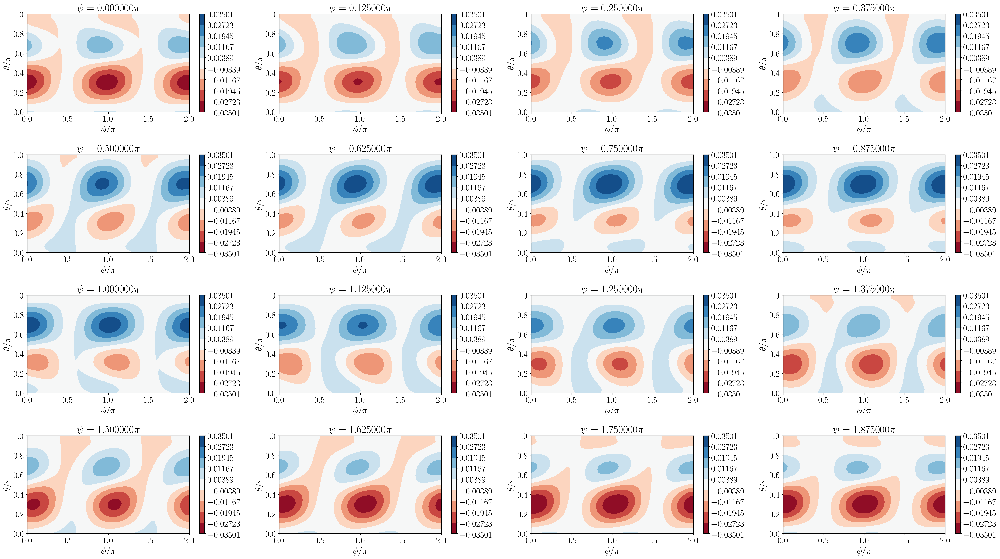

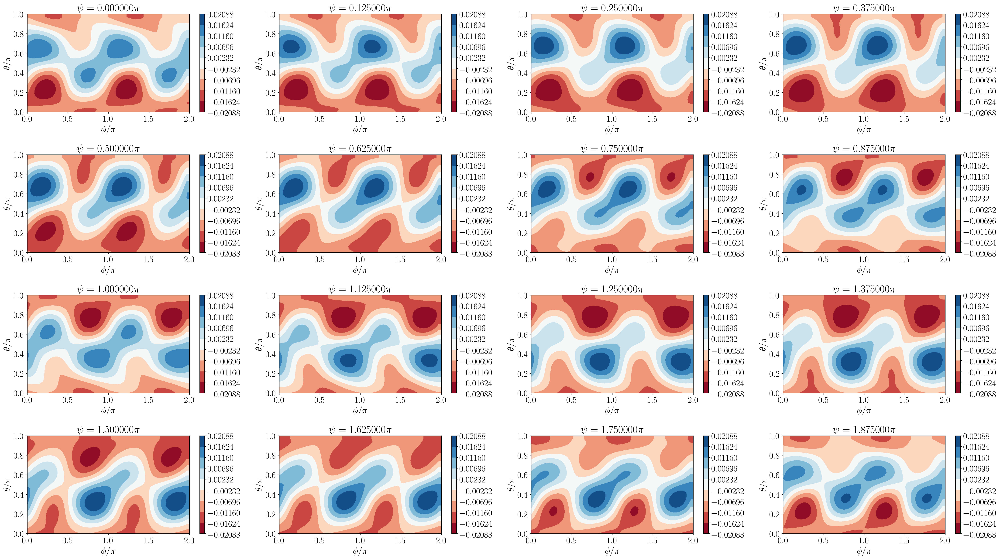

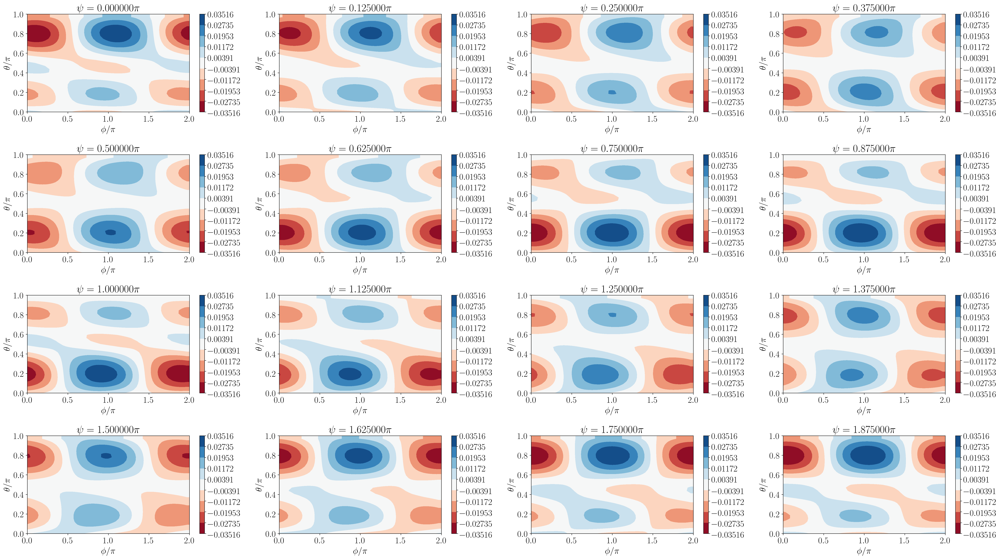

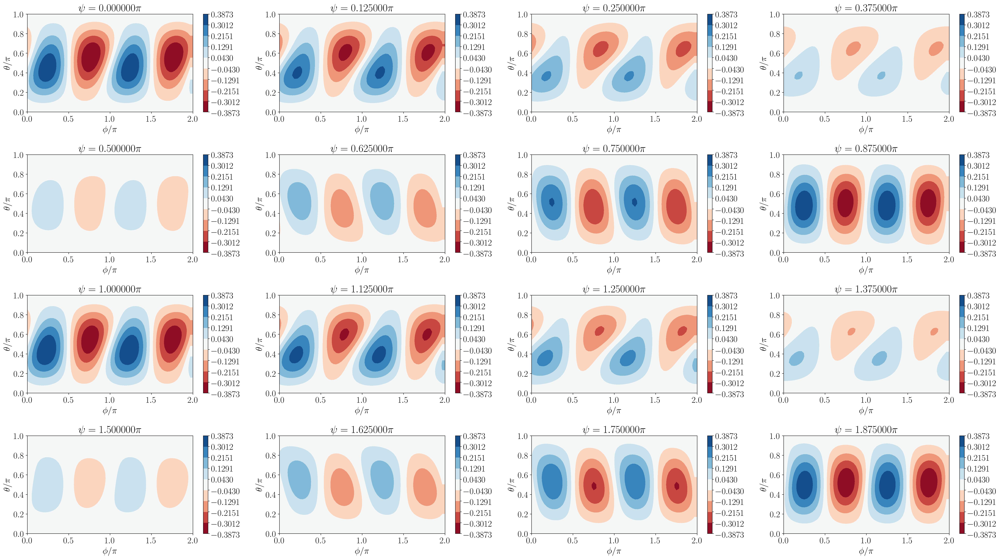

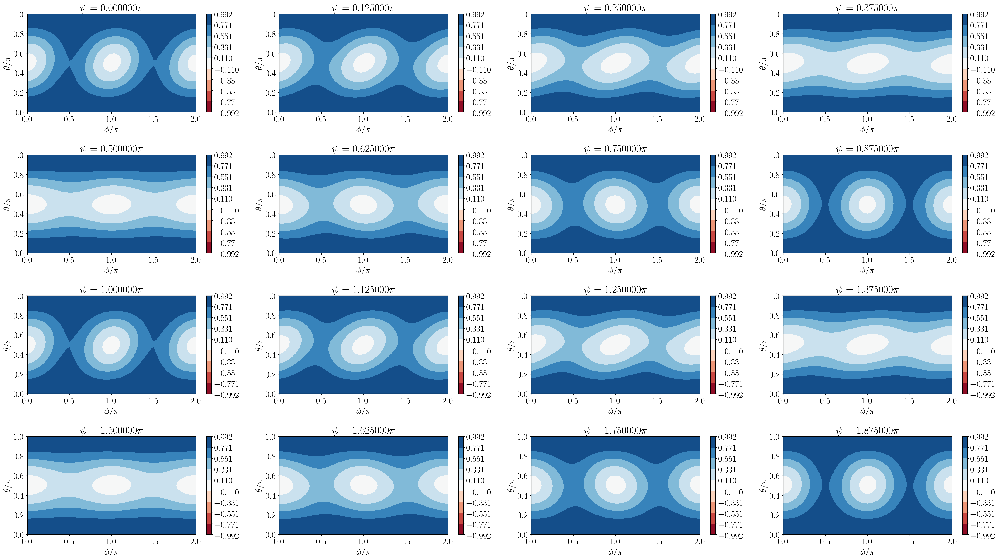

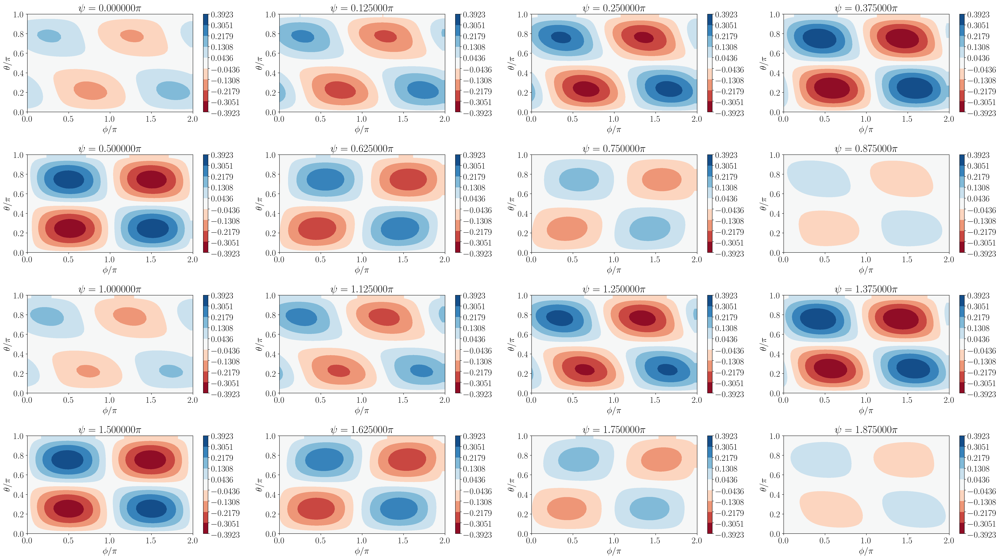

In [1697]:
for use_uidx in (0, 1, 2, 3, 4, 5):
    tu_cal = np.dstack(U_cal_all[use_uidx])
    spf_tb.show_ui_psi(tu_cal, ttheta_all, tphi_all, tpsi_all, dpi=200)

0.0004479347188867111
0.00031504931884451803
0.000438265961148529


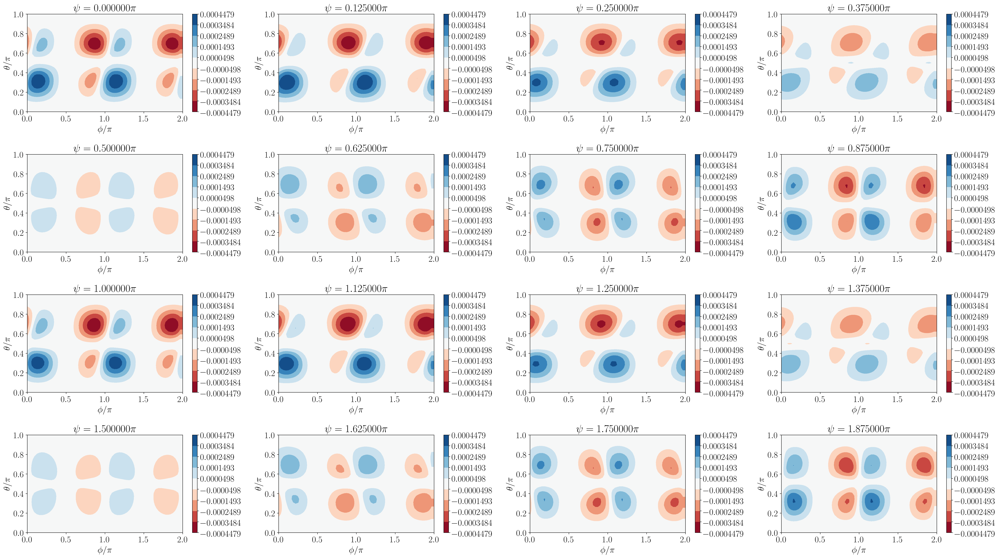

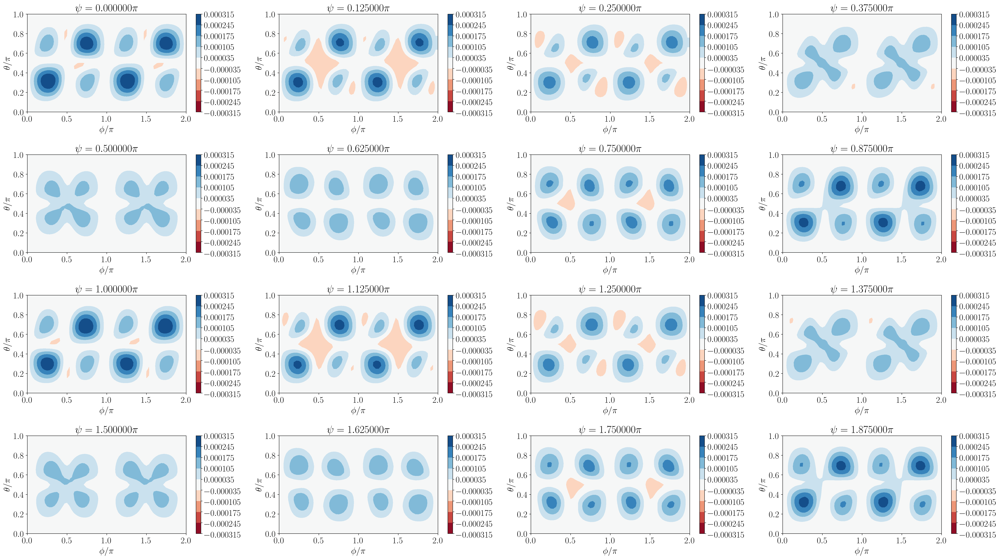

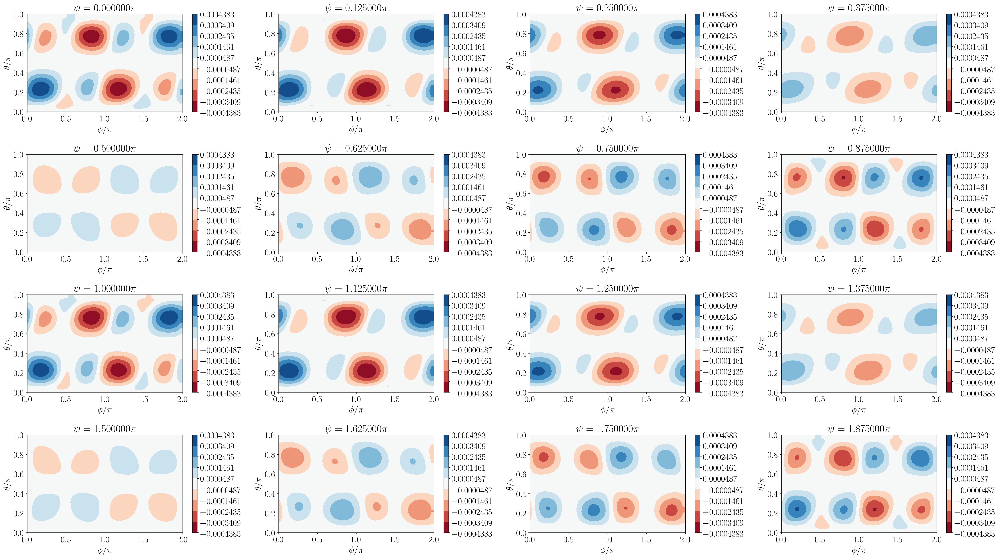

In [1698]:
for use_uidx in (3, 4, 5):
    tu = np.dstack(U_all[use_uidx])
    tu_cal = np.dstack(U_cal_all[use_uidx])
    t1 = tu_cal - tu
    print(np.abs(t1).max())
    spf_tb.show_ui_psi(t1, ttheta_all, tphi_all, tpsi_all, dpi=200)

## show the slice of base flows

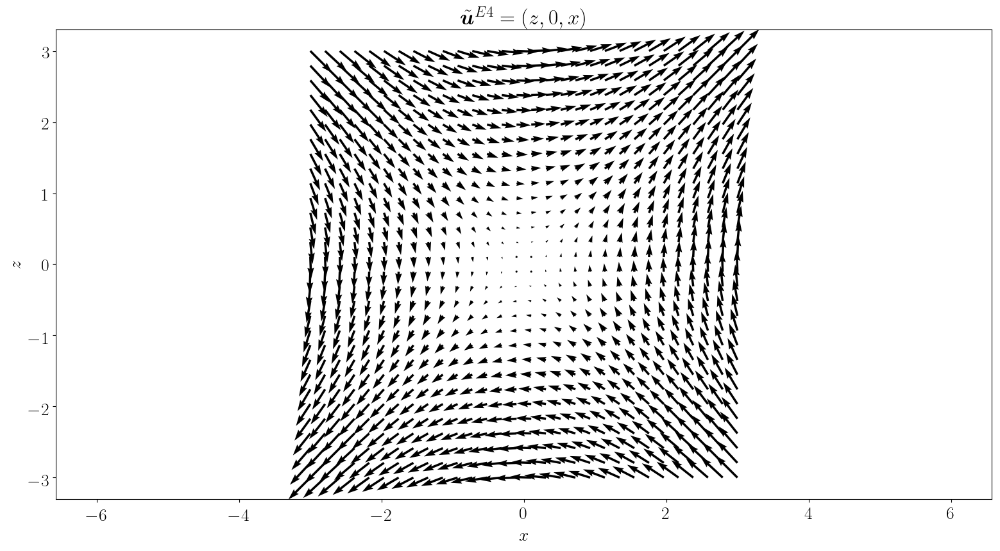

In [1604]:
figsize = np.array((16, 9)) * 1
dpi = 100

t1, t2 = np.meshgrid(np.linspace(-3, 3, 30), np.linspace(-3, 3, 30), indexing='ij')
# u1, u2 = t1, -t2
# title = '$\\tilde{\\bm{u}}^{E1} = (x, -y, 0)$'
# xlabel, ylabel = '$x$', '$y$'

# u1, u2 = -t1, t2
# title = '$\\tilde{\\bm{u}}^{E2} = (0, -y, z)$'
# xlabel, ylabel = '$y$', '$z$'

# u1, u2 = t2, t1
# title = '$\\tilde{\\bm{u}}^{E3} = (y, x, 0)$'
# xlabel, ylabel = '$x$', '$y$'

u1, u2 = t2, t1
title = '$\\tilde{\\bm{u}}^{E4} = (z, 0, x)$'
xlabel, ylabel = '$x$', '$z$'

# u1, u2 = t2, t1
# title = '$\\tilde{\\bm{u}}^{E5} = (0, y, x)$'
# xlabel, ylabel = '$y$', '$z$'

fig, axs = plt.subplots(1, 1, figsize=figsize, dpi=dpi)
fig.patch.set_facecolor('white')
axi = axs
axi.quiver(t1, t2, u1, u2)
axi.axis('equal')
axi.set_title(title)
axi.set_xlabel(xlabel)
axi.set_ylabel(ylabel)
plt.tight_layout()

In [61]:
from shutil import copyfile

# pickle_name = 'ecoC01B05_baseFlow'
# mdf_pickle_name = 'ecoC01B05_baseFlow_mdf'

# pickle_name = 'ecoB01_baseFlow'
# mdf_pickle_name = 'ecoB01_baseFlow_mdf'

# pickle_name = 'hlxC02B05_baseFlow'
# mdf_pickle_name = 'hlxC02B05_baseFlow_mdf'

# pickle_name = 'hlxC03B05_baseFlow'
# mdf_pickle_name = 'hlxC03B05_baseFlow_mdf'
with open('%s.pickle' % pickle_name, 'rb') as handle:
    pickle_dict = pickle.load(handle)
display(np.vstack(pickle_dict['uw_Base_list'])[1:6, 3:])

t1 = pickle_dict['uw_Base_list'].copy()
# for i0 in (0, 6, 7, 8, 9):
for i0 in (0, 1, 2, 3, 4, 5, 6, 7, 8, 9):
    t1[i0] = np.zeros_like(t1[i0])
# # t1[2][5] = pickle_dict['uw_Base_list'][2][5]
# ta1 = (pickle_dict['uw_Base_list'][4][3] + pickle_dict['uw_Base_list'][5][4]) / 2
# ta2 = (pickle_dict['uw_Base_list'][4][4] - pickle_dict['uw_Base_list'][5][3]) / 2
# t1[4][3] = ta1
# t1[4][4] = ta2
# t1[5][3] = -ta2
# t1[5][4] = ta1
# t1[9] = pickle_dict['uw_Base_list'][9]
# display(np.vstack(t1)[1:6, 3:])

# t1[2][5] = pickle_dict['uw_Base_list'][2][5]
ta2 = (pickle_dict['uw_Base_list'][4][4] + pickle_dict['uw_Base_list'][5][3]) / 2
t1[3][5] = pickle_dict['uw_Base_list'][3][5]
t1[4][4] = pickle_dict['uw_Base_list'][4][4]
t1[5][3] = pickle_dict['uw_Base_list'][5][3]
# t1[4][4] = -ta2
# t1[5][3] = -ta2
t1[9] = pickle_dict['uw_Base_list'][9]
display(np.vstack(t1)[1:6, 3:])

pickle_dict['uw_Base_list'] = t1
tname = '%s.pickle' % mdf_pickle_name
with open(tname, 'wb') as handle:
    pickle.dump(pickle_dict, handle, protocol=pickle.HIGHEST_PROTOCOL)
copyfile(tname, os.path.join(os.getcwd(), os.pardir, os.pardir, 'src', tname))
print('save table_data to %s' % tname)


array([[ 8.52557836e-06, -1.08471925e-06, -2.84475197e-07],
       [ 9.76759689e-06,  3.29143951e-08,  5.75166569e-07],
       [-9.69034533e-08, -2.98171981e-07,  9.65181431e-01],
       [-1.67252037e-07, -9.48863747e-01, -3.89043842e-06],
       [-3.79998248e-02, -7.90232568e-09,  2.52878755e-08]])

array([[ 0.        ,  0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.96518143],
       [ 0.        , -0.94886375,  0.        ],
       [-0.03799982,  0.        ,  0.        ]])

save table_data to hlx2_rh11_1.000_ph_6.67_baseFlow_mdf.pickle
